In [42]:
import sys
sys.path.append("..")

In [47]:
import os
import six
import math
from datetime import datetime, timedelta

import numpy as np
from scipy import stats
import pandas as pd
import ast
import scipy
import SimpleITK as sitk

# import plotly
# import plotly.offline as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode()
# plotly.tools.set_credentials_file(username='sadeghsalehi1', api_key='2DewR1PdmyzkzYcJX2qN')
# import seaborn as sns
import tensorflow as tf

from keras.models import Model, Sequential
from keras.layers import (Input,
                          Reshape,
                          Flatten,
                          Dense, 
                          Dropout, 
                          add, concatenate,
                          LSTM, CuDNNLSTM, 
                          Embedding, 
                          Lambda, 
                          Activation,
                          Bidirectional,
                          Conv2D, 
                          MaxPooling3D, 
                          Conv3D,
                          MaxPooling2D, AveragePooling2D)
from keras.layers.wrappers import TimeDistributed
from keras.callbacks import (EarlyStopping, 
                             ReduceLROnPlateau, 
                             ModelCheckpoint, 
                             TensorBoard, 
                             LearningRateScheduler)

from keras.optimizers import Adam, Nadam, SGD, Optimizer, RMSprop
from keras.regularizers import l1, l2
from keras.layers.normalization import BatchNormalization
from keras.utils.vis_utils import plot_model, model_to_dot
from keras.utils import Sequence, multi_gpu_model
from keras import backend as K
from keras.utils.generic_utils import serialize_keras_object
from keras.utils.generic_utils import deserialize_keras_object
# from keras.legacy import interfaces

from sklearn.model_selection import train_test_split

import click
import numpy as np
import dill as pickle
import pydot_ng as pydot
import SimpleITK as sitk
import cv2 as cv
from tqdm import tqdm_notebook as tqdm

from scipy.interpolate import Rbf, InterpolatedUnivariateSpline

from IPython.display import SVG
from IPython.display import HTML, display

from utils.keras_callbacks import (LRFinder, 
                                   UnrollOnLossPlateau,
                                   SGDRScheduler)
import matplotlib.pyplot as plt # Because keras_callbacks 

from utils.losses import geodesic, Pitanh
from models.tres_model import PReLU
# from models.lstm_peephole import LSTMPeephole
# from utils import random_sine, plot_prediction

from utils.img import (generate_img_angle, whitening,
                       vrrotmat2vec, create_rotation_matrix, vec5_to_vec3,
                       get_rotational_spline_generators,
                       get_translational_spline_generators)

import dill as pickle

In [44]:
%matplotlib inline

In [45]:
# import os
# os.environ["CUDA_VISIBLE_DEVICES"]="0,1,2"

# config = tf.ConfigProto()
# config.gpu_options.allow_growth=True
# sess = tf.Session(config=config)
# keras.backend.set_session(sess)

def _get_available_devices():
    from tensorflow.python.client import device_lib
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos]

_get_available_devices()

['/device:CPU:0']

* Baselines: https://machinelearningmastery.com/multi-step-time-series-forecasting/
* Source: https://github.com/LukeTonin/keras-seq-2-seq-signal-prediction
* Tutorial: https://weiminwang.blog/2017/09/29/multivariate-time-series-forecast-using-seq2seq-in-tensorflow/

## Hyperparameters and model configuration
This model uses a Gated Recurrent Unit (GRU). Other units (LSTM) would also work with a few modifications to the code.

In [46]:
ROW_AXIS     = 2
COL_AXIS     = 3
CHANNEL_AXIS = 4
WIDTH = 155
HEIGHT = 135
RESIZE_DIM = 128
NB_TIMESTEPS = 10
WINDOW = NB_TIMESTEPS//2
NB_CHANNELS = 1
NB_ANGLES, EST_SLICE_CLASSES, PRED_SLICE_CLASSES = 3, 5, 5
NB_SAMPLES = 25
SPEED = 5
BATCH_SIZE = 32

DATA_PATH = '/host/home/exx/Documents/resources/Data/'
TRAIN_DATA_PATH = DATA_PATH+'controls/'
TEST_DATA_PATH = DATA_PATH+'Test/'

In [24]:
train_files = os.listdir(TRAIN_DATA_PATH)
train_files.sort()
train_files, validation_files = train_files[:30], train_files[30:]

FileNotFoundError: [Errno 2] No such file or directory: '/host/home/exx/Documents/resources/Data/controls/'

In [25]:
def data_generation(path=TRAIN_DATA_PATH, sampling_ratio=1.0, files=None, mask=False, shuffle=False,
                 est_nb_timesteps=10, pred_nb_timesteps=10, teacher_force=False, batch_size=1, h=155, w=135, 
                   speeds=None):
    'generates data containing batch_size samples'
    if not speeds:
        speeds = [4]*4 + [5]*5 + [6]*6 + [7]*8 + [8]*9
    nb_samples = len(speeds)
    nb_files = len(files)
    imgs = np.zeros([nb_files*nb_samples, est_nb_timesteps, h, w, 1])
    rotational = np.zeros([nb_files*nb_samples, est_nb_timesteps + pred_nb_timesteps, NB_ANGLES])  
    offset = np.zeros([nb_files*nb_samples, est_nb_timesteps + pred_nb_timesteps, NB_CHANNELS])
    for counter, file_name in enumerate(tqdm(files)):
        image = sitk.ReadImage(path + file_name)
        for i in range(nb_samples):
            ius_x, ius_y, ius_z, rotation_matrix_init = get_rotational_spline_generators(est_nb_timesteps + pred_nb_timesteps, speed=speeds[i])
            timestep_to_mask = np.random.randint(low=0, high=est_nb_timesteps, size=1)[0] if mask else est_nb_timesteps + 1

            for timestep in range(est_nb_timesteps + pred_nb_timesteps):
                z = 70+timestep*5
                img, angle_offsets = generate_img_angle(timestep, 
                                                        image, 
                                                        ius_x, ius_y, ius_z, 
                                                        rotation_matrix_init)
                rotational[nb_samples*counter+i, timestep, :] = angle_offsets

                offset[nb_samples*counter+i, timestep, 0] = z
                if timestep < est_nb_timesteps:
                    if h == 128:
                        img = cv.resize(img, dsize=(h, w), interpolation=cv.INTER_NEAREST)
                    # randomly mask a timestep with all black image
                    if timestep == timestep_to_mask:
                        img = np.zeros((h, w))
                    
                    imgs[nb_samples*counter+i, timestep, :, :, 0] = whitening(img)

    encoder_input = np.zeros((imgs.shape[0], est_nb_timesteps, imgs.shape[2], imgs.shape[3], NB_CHANNELS))
    decoder_input = np.zeros((imgs.shape[0], pred_nb_timesteps, NB_ANGLES+1))
    encoder_estimation_offset_z = np.zeros((imgs.shape[0], est_nb_timesteps, 1))
    encoder_estimation_rotation_xy = np.zeros((imgs.shape[0], est_nb_timesteps, 2))
    encoder_estimation_rotation_z = np.zeros((imgs.shape[0], est_nb_timesteps, 1))
    decoder_prediction_offset_z = np.zeros((imgs.shape[0], pred_nb_timesteps, 1))
    decoder_prediction_rotation_xy = np.zeros((imgs.shape[0], pred_nb_timesteps, 2))
    decoder_prediction_rotation_z = np.zeros((imgs.shape[0], pred_nb_timesteps, 1))
    for i in range(imgs.shape[0]):
        encoder_input[i, :est_nb_timesteps] = imgs[i, :est_nb_timesteps]

        encoder_estimation_rotation_xy[i] = rotational[i, :est_nb_timesteps, :2]               
        decoder_prediction_rotation_xy[i] = rotational[i, est_nb_timesteps:, :2]       
        encoder_estimation_rotation_z[i] = rotational[i, :est_nb_timesteps, 2:]  
        decoder_prediction_rotation_z[i] = rotational[i, est_nb_timesteps:, 2:]        
        encoder_estimation_offset_z[i] = offset[i, :est_nb_timesteps]
        decoder_prediction_offset_z[i] = offset[i, est_nb_timesteps:] 

        # help decoder by showing current input
        if teacher_force:
            decoder_input[i, :est_nb_timesteps] = rotational[i, est_nb_timesteps:]

    x = {"encoder_input": encoder_input, "decoder_input": decoder_input}
    y = {"estimation_offset_z": encoder_estimation_offset_z, 
         "estimation_rotation_xy": encoder_estimation_rotation_xy,
         "estimation_rotation_z": encoder_estimation_rotation_z,
         "prediction_offset_z": decoder_prediction_offset_z, 
         "prediction_rotation_xy": decoder_prediction_rotation_xy,
         "prediction_rotation_z": decoder_prediction_rotation_z}

    return x, y

def sp_noise(image, prob):
    '''
    add salt and pepper noise to image
    prob: probability of the noise
    '''
    output = np.zeros(image.shape,np.uint8)
    thres = 1 - prob 
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            rdn = random.random()
            if rdn < prob:
                output[i][j] = 0
            elif rdn > thres:
                output[i][j] = 255
            else:
                output[i][j] = image[i][j]
    return output

In [605]:
train_X, train_y = data_generation(files=train_files)

HBox(children=(IntProgress(value=0, max=30), HTML(value='')))

SystemError: <built-in function Resample> returned a result with an error set

In [13]:
test_files = os.listdir(TEST_DATA_PATH)
# test_X, test_y = data_generation(path=TEST_DATA_PATH, files=test_files, mask=True)

In [14]:
# test_files.sort()
test_files

['27_c160_f092.nii.gz',
 '35_c160_f122.nii.gz',
 '29_c160_f051.nii.gz',
 '29_c160_f060.nii.gz',
 '28_c160_f011.nii.gz',
 '28_c160_f025.nii.gz',
 '28_c160_f083.nii.gz',
 '28_c160_f031.nii.gz',
 '27_c160_f027.nii.gz',
 '28_c160_f190.nii.gz',
 '32_c160_f215.nii.gz',
 '35_c160_f097.nii.gz',
 '26_c160_f010.nii.gz',
 '31_c160_f169.nii.gz',
 '31_c160_f050.nii.gz',
 '29_c160_f081.nii.gz',
 '29_c160_f234.nii.gz',
 '30_c160_f048.nii.gz',
 '28_c160_f071.nii.gz',
 '27_c160_f073.nii.gz',
 '34_c160_f101.nii.gz',
 '36_c160_f094.nii.gz',
 '33_c160_f237.nii.gz',
 '34_c160_f045.nii.gz',
 '28_c160_f017.nii.gz',
 '27_c160_f077.nii.gz',
 '29_c160_f203.nii.gz',
 '30_c160_f166.nii.gz',
 '34_c160_f121.nii.gz',
 '30_c160_f039.nii.gz',
 '36_c160_f080.nii.gz',
 '28_c160_f043.nii.gz',
 '27_c160_f024.nii.gz',
 '35_c160_f184.nii.gz',
 '29_c160_f197.nii.gz',
 '28_c160_f016.nii.gz',
 '34_c160_f103.nii.gz',
 '33_c160_f000.nii.gz',
 '28_c160_f033.nii.gz',
 '33_c160_f105.nii.gz']

In [104]:
train_X['encoder_input'].shape

(960, 10, 155, 135, 1)

In [608]:
# masked: 
# original: ../data/test_155_135_1280seqs.pkl
with open('../data/test_masked_155_135_1280seqs.pkl', 'wb') as file:
    pickle.dump([test_X, test_y], file)

In [48]:
with open('../data/test_masked_155_135_1280seqs.pkl', 'rb') as file:
    test_X, test_y = pickle.load(file)

In [49]:
def mse(x, y, axis=1):
    return ((x - y) ** 2).mean(axis=axis)

In [50]:
def get_loss_with_names(model, X, y):
    return [(name, score) for name, score in zip(model.metrics_names, model.evaluate(X, y, verbose=0))]

In [19]:
# Posenet requires reshaping
get_loss_with_names(our_model, test_X['encoder_input'].reshape((12800, 155, 135, 1)), 
                   {'estimation_offset_z': test_y['estimation_offset_z'].reshape((12800, 1)), 
                   'estimation_rotation': np.concatenate((test_y['estimation_rotation_xy'], 
                                           test_y['estimation_rotation_z']), 
                                               axis=2).reshape(((12800, 3)))}) # PoseNet (ResNet18)

NameError: name 'our_model' is not defined

In [30]:
test_X.keys(), test_y.keys()

(dict_keys(['decoder_input', 'encoder_input']),
 dict_keys(['estimation_rotation_z', 'estimation_offset_z', 'prediction_rotation_z', 'prediction_offset_z', 'estimation_rotation_xy', 'prediction_rotation_xy']))

In [567]:
# Est 3 steps
test_X, test_y = gen_data(nb_timesteps_est=3, nb_timesteps_pred=12)
get_loss_with_names(model, test_X, test_y)

HBox(children=(IntProgress(value=0, max=40), HTML(value='')))

# Total samples: 1200 each with 3 estimation and 12 prediction timesteps
(1200, 3, 155, 135, 1) (1200, 15, 3) (1200, 15, 1)


[('loss', 1.8201343901952107),
 ('estimation_offset_z_loss', 0.012114997295041879),
 ('estimation_rotation_xy_loss', 0.34183833519617718),
 ('estimation_rotation_z_loss', 0.274287352959315),
 ('prediction_offset_z_loss', 0.029495255723595619),
 ('prediction_rotation_xy_loss', 0.72305711110432946),
 ('prediction_rotation_z_loss', 0.4393413253625234)]

In [51]:
from collections import defaultdict

In [817]:
speed_loss = {name: [] for name in model.metrics_names}
speed_loss['speed'] = []
for start, end in [(0,4),(4,9),(9,15),(15,22),(22, 32)]:
    speed = end-start
    print("Speed", (end-start))
    loss = get_loss_with_names(model, {'encoder_input': np.array([test_X_128['encoder_input'][i+start:i+end] for i in range(0, 1280, 32)]).reshape((40*(end-start), 10, 128, 128, 1)), 
                                'decoder_input':np.array([test_X_128['decoder_input'][i+start:i+end] for i in range(0, 1280, 32)]).reshape((40*(end-start), 10, 4))}, 
                           {k: np.array([test_y[k][i+start:i+end] for i in range(0, 1280, 32)]).reshape((40*(end-start), 10, test_y[k].shape[2])) for k in test_y.keys()})
    print(loss)
    speed_loss['speed'].append(speed)
    for loss_name, loss_value in loss:
        speed_loss[loss_name].append(loss_value)

Speed 4
[('loss', 0.3209728956222534), ('estimation_offset_z_loss', 0.0049697709269821647), ('estimation_rotation_xy_loss', 0.017376560345292093), ('estimation_rotation_z_loss', 0.01720909997820854), ('prediction_offset_z_loss', 0.0036718671675771476), ('prediction_rotation_xy_loss', 0.15356612950563431), ('prediction_rotation_z_loss', 0.12417946755886078)]
Speed 5
[('loss', 0.3131793236732483), ('estimation_offset_z_loss', 0.0045007326081395148), ('estimation_rotation_xy_loss', 0.019440668672323226), ('estimation_rotation_z_loss', 0.01867292869836092), ('prediction_offset_z_loss', 0.0035486788302659987), ('prediction_rotation_xy_loss', 0.13021786451339723), ('prediction_rotation_z_loss', 0.13679844379425049)]
Speed 6
[('loss', 0.32505989869435631), ('estimation_offset_z_loss', 0.0046304239270587759), ('estimation_rotation_xy_loss', 0.021780671179294588), ('estimation_rotation_z_loss', 0.016345580543080964), ('prediction_offset_z_loss', 0.0041474375563363237), ('prediction_rotation_xy_

In [818]:
df_speed = pd.DataFrame(speed_loss)
df_speed.index = df_speed.speed
df_speed.head()

,estimation_offset_z_loss,estimation_rotation_xy_loss,estimation_rotation_z_loss,loss,prediction_offset_z_loss,prediction_rotation_xy_loss,prediction_rotation_z_loss,speed
speed,,,,,,,,
4,0.004970,0.017377,0.017209,0.320973,0.003672,0.153566,0.124179,4
5,0.004501,0.019441,0.018673,0.313179,0.003549,0.130218,0.136798,5
6,0.004630,0.021781,0.016346,0.325060,0.004147,0.138739,0.139417,6
7,0.004697,0.019044,0.017303,0.328387,0.004294,0.147301,0.135749,7
10,0.004444,0.019694,0.016900,0.330794,0.003929,0.147599,0.138228,10


In [99]:
df_speed['estimation_loss'] = df_speed['estimation_offset_z_loss'] + \
                              df_speed['estimation_rotation_xy_loss'] + \
                              df_speed['estimation_rotation_z_loss']

In [101]:
df_speed['prediction_loss'] = df_speed['prediction_offset_z_loss'] + \
                              df_speed['prediction_rotation_xy_loss'] + \
                              df_speed['prediction_rotation_z_loss']

In [94]:
import seaborn as sns

In [25]:
test_X, test_y = gen_data()
# print(test_X, test_y)
get_loss_with_names(model, test_X, test_y)
# [('loss', 0.18657187819480897), ('estimation_loss', 0.027900866791605951), ('prediction_loss', 0.15867100656032562)]
# Teacher Force: [('loss', 0.1526935338973999), ('estimation_loss', 0.021729700639843939), ('prediction_loss', 0.1309638276696205)]

NameError: name 'gen_data' is not defined

In [69]:
get_loss_with_names(model, test_X_volunteer, test_y_volunteer)

[('loss', 0.097890000045299533),
 ('estimation_offset_z_loss', 0.025003406107425689),
 ('estimation_rotation_xy_loss', 0.031771106347441673),
 ('estimation_rotation_z_loss', 0.041115487515926363)]

In [20]:
import seaborn as sns

In [129]:
model.save("../models/MSE_zOffset_zRotOffset_xyRotOffset") # Original model with 6 heads

In [295]:
model.save("../models/ResAngNet") # ResAngNet

/usr/local/lib/python3.5/dist-packages/keras/engine/topology.py:2368: UserWarning:

Layer decoder_rnn was passed non-serializable keyword arguments: {'initial_state': [<tf.Tensor 'encoder_rnn_7/strided_slice_16:0' shape=(?, 512) dtype=float32>, <tf.Tensor 'encoder_rnn_7/strided_slice_17:0' shape=(?, 512) dtype=float32>]}. They will not be included in the serialized model (and thus will be missing at deserialization time).



In [295]:
model.save("../models/original_model_minus_RNN") 

/usr/local/lib/python3.5/dist-packages/keras/engine/topology.py:2368: UserWarning:

Layer decoder_rnn was passed non-serializable keyword arguments: {'initial_state': [<tf.Tensor 'encoder_rnn_7/strided_slice_16:0' shape=(?, 512) dtype=float32>, <tf.Tensor 'encoder_rnn_7/strided_slice_17:0' shape=(?, 512) dtype=float32>]}. They will not be included in the serialized model (and thus will be missing at deserialization time).



In [395]:
model.save("../models/posenet")

In [463]:
model.save("../models/svrnet")

In [52]:
def resize_to_NxN(X, n=128):
    total_samples, timesteps, h, w, channels = X['encoder_input'].shape
    X_128 = {'encoder_input': np.zeros((total_samples, timesteps, n, n, channels)), 
             'decoder_input': X['decoder_input']}
    for i in range(total_samples):
        for j in range(timesteps):
            X_128['encoder_input'][i, j, :] = cv.resize(X['encoder_input'][i,j].reshape((h, w)), dsize=(n, n), 
                                                        interpolation=cv.INTER_NEAREST).reshape((n,n,channels))
    return X_128

In [53]:
# train_X_128 = resize_to_NxN(train_X)
test_X_128 = resize_to_NxN(test_X)

In [56]:
test_X_128.keys()

dict_keys(['encoder_input', 'decoder_input'])

In [57]:
from keras.models import load_model

In [58]:
our_model = load_model("../models/ourModel_pred", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
our_model.output_names

Instructions for updating:
Use the retry module or similar alternatives.


InvalidArgumentError: No OpKernel was registered to support Op 'CudnnRNN' with these attrs.  Registered devices: [CPU], Registered kernels:
  <no registered kernels>

	 [[Node: encoder_rnn/CudnnRNN = CudnnRNN[T=DT_FLOAT, direction="unidirectional", dropout=0, input_mode="linear_input", is_training=true, rnn_mode="lstm", seed=87654321, seed2=0](encoder_rnn/transpose, encoder_rnn/ExpandDims_1, encoder_rnn/ExpandDims_2, encoder_rnn/concat_1)]]

Caused by op 'encoder_rnn/CudnnRNN', defined at:
  File "/usr/local/Cellar/python/3.6.4_4/Frameworks/Python.framework/Versions/3.6/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/usr/local/Cellar/python/3.6.4_4/Frameworks/Python.framework/Versions/3.6/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 486, in start
    self.io_loop.start()
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tornado/ioloop.py", line 888, in start
    handler_func(fd_obj, events)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/zmq/eventloop/zmqstream.py", line 450, in _handle_events
    self._handle_recv()
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/zmq/eventloop/zmqstream.py", line 480, in _handle_recv
    self._run_callback(callback, msg)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/zmq/eventloop/zmqstream.py", line 432, in _run_callback
    callback(*args, **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 233, in dispatch_shell
    handler(stream, idents, msg)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel/kernelbase.py", line 399, in execute_request
    user_expressions, allow_stdin)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel/ipkernel.py", line 208, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/ipykernel/zmqshell.py", line 537, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2662, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2785, in _run_cell
    interactivity=interactivity, compiler=compiler, result=result)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2903, in run_ast_nodes
    if self.run_code(code, result):
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 2963, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-58-f279b300d74b>", line 1, in <module>
    our_model = load_model("../models/ourModel_pred", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/models.py", line 243, in load_model
    model = model_from_config(model_config, custom_objects=custom_objects)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/models.py", line 317, in model_from_config
    return layer_module.deserialize(config, custom_objects=custom_objects)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/layers/__init__.py", line 55, in deserialize
    printable_module_name='layer')
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/utils/generic_utils.py", line 144, in deserialize_keras_object
    list(custom_objects.items())))
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/engine/topology.py", line 2524, in from_config
    process_node(layer, node_data)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/engine/topology.py", line 2481, in process_node
    layer(input_tensors[0], **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/layers/recurrent.py", line 499, in __call__
    return super(RNN, self).__call__(inputs, **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/engine/topology.py", line 619, in __call__
    output = self.call(inputs, **kwargs)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/layers/cudnn_recurrent.py", line 90, in call
    output, states = self._process_batch(inputs, initial_state)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/keras/layers/cudnn_recurrent.py", line 510, in _process_batch
    is_training=True)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/contrib/cudnn_rnn/python/ops/cudnn_rnn_ops.py", line 1480, in __call__
    input_data, input_h, input_c, params, is_training=is_training)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/contrib/cudnn_rnn/python/ops/cudnn_rnn_ops.py", line 1371, in __call__
    seed=self._seed)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/contrib/cudnn_rnn/python/ops/cudnn_rnn_ops.py", line 860, in _cudnn_rnn
    name=name)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/contrib/cudnn_rnn/ops/gen_cudnn_rnn_ops.py", line 110, in cudnn_rnn
    is_training=is_training, name=name)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/python/framework/op_def_library.py", line 787, in _apply_op_helper
    op_def=op_def)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/python/framework/ops.py", line 3290, in create_op
    op_def=op_def)
  File "/Users/asingh3/workspace/notebooks/lib/python3.6/site-packages/tensorflow/python/framework/ops.py", line 1654, in __init__
    self._traceback = self._graph._extract_stack()  # pylint: disable=protected-access

InvalidArgumentError (see above for traceback): No OpKernel was registered to support Op 'CudnnRNN' with these attrs.  Registered devices: [CPU], Registered kernels:
  <no registered kernels>

	 [[Node: encoder_rnn/CudnnRNN = CudnnRNN[T=DT_FLOAT, direction="unidirectional", dropout=0, input_mode="linear_input", is_training=true, rnn_mode="lstm", seed=87654321, seed2=0](encoder_rnn/transpose, encoder_rnn/ExpandDims_1, encoder_rnn/ExpandDims_2, encoder_rnn/concat_1)]]


In [ ]:
our_model_estimation = our_model.predict(test_X_128)  # ['encoder_input'].reshape((12800, 155, 135, 1)))

In [ ]:
df_our_model_est = pd.DataFrame(np.concatenate(((test_y['estimation_rotation_z'] - our_model_prediction[2])**2,
                                                (test_y['estimation_rotation_xy'] - our_model_prediction[1])**2),
                                    axis=2).sum(axis=2), 
                       columns=list(range(10))).melt()
df_our_model_est.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [864]:
svrnet = load_model("../models/svrnet", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
svrnet.output_names

/usr/local/lib/python3.5/dist-packages/tensorflow/python/util/tf_inspect.py:45: DeprecationWarning:

inspect.getargspec() is deprecated, use inspect.signature() instead



['estimation_offset_z', 'estimation_rotation_xy', 'estimation_rotation_z']

In [913]:
svrnet_estimation = np.zeros((1280, 10, 3))
for i in range(test_X['encoder_input'].shape[0]):
    for j, loss in enumerate(svrnet.predict({"encoder_input": test_X['encoder_input'][i:i+1], 
                               "decoder_input": test_X['decoder_input'][i:i+1]})):
        if j == 1:
            svrnet_estimation[i, :, j] = loss[0].sum(axis=1)
        else:
            svrnet_estimation[i, :, j] = loss[0].reshape(10)            

# BUG:     - [ ] VGG16 is predicting constant all of a sudden

In [ ]:
# print(test_y['estimation_rotation_z'][1])
for i in range(2):
    print(model_prediction[0][i])

In [926]:
np.concatenate((test_y['estimation_rotation_z'], test_y['estimation_rotation_xy']), axis=2).sum(axis=2).shape

(1280, 10)

In [927]:
df_svrnet = pd.DataFrame((np.concatenate((test_y['estimation_rotation_z'], 
                                         test_y['estimation_rotation_xy']), axis=2).sum(axis=2)
                         - np.array((svrnet_estimation))[:, :, 1:].sum(axis=2))**2, 
                         columns=list(range(10))).melt()
df_svrnet.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [16]:
posenet = load_model("../models/posenet", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
posenet.output_names

/usr/local/lib/python3.5/dist-packages/tensorflow/python/util/tf_inspect.py:45: DeprecationWarning:

inspect.getargspec() is deprecated, use inspect.signature() instead



['estimation_offset_z', 'estimation_rotation']

In [859]:
posenet_estimation = posenet.predict(test_X['encoder_input'].reshape((12800, 155, 135, 1)))

In [861]:
df_posenet = pd.DataFrame(((np.concatenate((test_y['estimation_rotation_xy'], 
                                           test_y['estimation_rotation_z']), axis=2).reshape((12800, 3))
                           - posenet_estimation[1])**2).sum(axis=1).reshape((1280, 10)), 
                       columns=list(range(10))).melt()
df_posenet.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [18]:
df_our_model_est['loss'].mean()

NameError: name 'df_our_model_est' is not defined

In [930]:
trace0 = go.Box(
    x=df_our_model_est['timestep'],
    y=df_our_model_est['loss'],
    name='Our model',
    boxpoints='outliers',
    marker = dict(color = 'rgba(44, 160, 101, 0.5)', opacity=.5),#636EFA
    #jitter=0.3,
    #pointpos=-1.8
    line=dict(width=1)
)
trace1 = go.Box(
    x=df_svrnet['timestep'],
    y=df_svrnet['loss'],
    name='VGG16',
    boxpoints='outliers',
    marker = dict(color = 'rgba(93, 164, 214, 0.5)', opacity=.5),
    #jitter=0.3,
    #pointpos=-1.8
    line=dict(width=1)
)
trace2 = go.Box(
    x=df_posenet['timestep'],
    y=df_posenet['loss'],
    name='Resnet18',
    boxpoints='outliers',
    marker = dict(color = 'rgba(255, 144, 14, 0.5)', opacity=.5),
    #jitter=0.3,
    #pointpos=-1.8
    line=dict(width=1)
)
layout = go.Layout(
    xaxis=dict(
        title='timestep',
        zeroline=False,
        tickmode='linear'
    ),
    yaxis=dict(
        title='squared error',
        zeroline=False,
        ticksuffix='&deg;'
    ),
    boxmode='group',
    legend=dict(orientation='v', x=.84, y=.93),  # x=0, y=-.075
    margin = {'r': 0, 't': 0, 'b': 60},
    font=dict(
            family='Menlo, monospace', 
              size=18, 
#               color='#7f7f7f'
             )
)
traces = [trace0, trace1, trace2]
fig = go.Figure(data=traces, layout=layout)
iplot(fig)

## Prediction plots

In [775]:
dLSTM = load_model("../models/directLSTM", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
dLSTM.output_names

/usr/local/lib/python3.5/dist-packages/tensorflow/python/util/tf_inspect.py:45: DeprecationWarning:

inspect.getargspec() is deprecated, use inspect.signature() instead



['estimation_offset_z',
 'estimation_rotation_xy',
 'estimation_rotation_z',
 'prediction_offset_z',
 'prediction_rotation_xy',
 'prediction_rotation_z']

In [776]:
dLSTM_prediction = dLSTM.predict(test_X)

In [828]:
df_lstm = pd.DataFrame(np.concatenate(((test_y['prediction_rotation_z'] - dLSTM_prediction[5])**2,
                                       (test_y['prediction_rotation_xy'] - dLSTM_prediction[4])**2),
                                    axis=2).sum(axis=2),  
                       columns=list(range(10))).melt()

df_lstm.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [777]:
our_model = load_model("../models/ourModel_pred", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
our_model.output_names

/usr/local/lib/python3.5/dist-packages/tensorflow/python/util/tf_inspect.py:45: DeprecationWarning:

inspect.getargspec() is deprecated, use inspect.signature() instead



['estimation_offset_z',
 'estimation_rotation_xy',
 'estimation_rotation_z',
 'prediction_offset_z',
 'prediction_rotation_xy',
 'prediction_rotation_z']

In [793]:
our_model_prediction = our_model.predict(test_X_128)

In [832]:
"""reshape doesn't apply properly leading to unmatched loss
df_pred['ourModel'] = np.concatenate(((test_y['prediction_rotation_z'] - our_model_prediction[5])**2,
                                      (test_y['prediction_rotation_xy'] - our_model_prediction[4])**2),
                                    axis=2).sum(axis=2).reshape((12800))
"""
df_our_model = pd.DataFrame(np.concatenate(((test_y['prediction_rotation_z'] - our_model_prediction[5])**2,
                                            (test_y['prediction_rotation_xy'] - our_model_prediction[4])**2),
                                    axis=2).sum(axis=2), 
                       columns=list(range(10))).melt()

df_our_model.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [692]:
# Rolling baseline, prediction from previous is used to predict current
def generate_img_from_angle(image, timestep, angles, pred=False, resize=True):
    rotation_matrix = create_rotation_matrix(angles)
    #rotation_matrix = np.matmul(rotation_matrix_mov, rotation_matrix_init)

    center_idx = np.asanyarray(image.GetSize())/2.
    rotation_center = image.TransformContinuousIndexToPhysicalPoint(center_idx)
    
    transformation = sitk.VersorRigid3DTransform()
    transformation.SetMatrix(rotation_matrix.ravel())
    transformation.SetCenter(rotation_center)

    transformedImg = sitk.Resample(image, transformation)
    img = sitk.GetArrayFromImage(transformedImg)
    img = img[:, int(timestep.round()), :] if pred else img[:, 70+timestep*5, :]
    if resize==True:
        img = cv.resize(img, dsize=(h, w), interpolation=cv.INTER_NEAREST)
    return whitening(img)       

In [1107]:
# Code for Auto regressive baseline
# Load image -> generate samples for estimation -> take first prediction and generate image -> feed back to model
nb_samples, timesteps, h, w, chanel = test_X_128['encoder_input'].shape
auto_regressive_loss = np.zeros((nb_samples, pred_nb_timesteps)) 

est_nb_timesteps, pred_nb_timesteps = timesteps, timesteps
total_timesteps = est_nb_timesteps + pred_nb_timesteps
    
pred_angles = np.concatenate((our_model_prediction[4][:, 0, :], 
                              our_model_prediction[5][:, 0, :]), axis=1)

encoder_input = np.zeros((test_X_128['encoder_input'].shape[0], total_timesteps, h, w, chanel))
encoder_input[:, :est_nb_timesteps, :] = test_X_128['encoder_input']
decoder_input = test_X_128['decoder_input']
for i in tqdm(range(nb_samples)):
    if i%32 == 0:
        image = sitk.ReadImage(TEST_DATA_PATH + test_files[i%32])
    # e.g. 10 pred timesteps, rest are offset by est_nb_timesteps + current_timestep-> 10, 11, ..
    for timestep in range(pred_nb_timesteps):
        prediction = our_model.predict({"encoder_input": encoder_input[i:i+1, timestep:est_nb_timesteps+timestep], 
                                    "decoder_input": decoder_input[i:i+1]})
        pred_angles = np.concatenate((prediction[4][:, 0, :], prediction[5][:, 0, :]), axis=1)[0]
        gt_angles = np.concatenate((test_y['prediction_rotation_xy'][i, 0, :], 
                                    test_y['prediction_rotation_z'][i, 0, :]))
        auto_regressive_loss[i, timestep] = ((gt_angles - pred_angles)**2).sum(axis=0)

        if timestep < pred_nb_timesteps - 1:
            img = generate_img_from_angle(image, est_nb_timesteps + timestep + 1, pred_angles, pred=False)
            encoder_input[i, est_nb_timesteps + timestep + 1, :] = img.reshape((h, w, chanel))

HBox(children=(IntProgress(value=0, max=1280), HTML(value='')))

In [1108]:
df_ar = pd.DataFrame(auto_regressive_loss, columns=list(range(10))).melt()
df_ar.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [982]:
df_zvb = pd.DataFrame(np.concatenate(((test_y['prediction_rotation_xy'][:, :, :] - 
                                       train_y['estimation_rotation_xy'][:, 9, :].mean(axis=0))**2,
                                       (test_y['prediction_rotation_z'][:, :, :] - 
                                        train_y['estimation_rotation_z'][:, 9, :].mean(axis=0))**2),
                                             axis=2).sum(axis=2), 
                       columns=list(range(10))).melt()

df_zvb.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

# Running mean of past 3 timestep as prediction
r3b_loss = np.zeros((1280, 10))
r3b_loss[:, 0] = np.concatenate(((test_y['prediction_rotation_xy'][:, 0, :] - train_y['estimation_rotation_xy'][:, 7:10, :].mean(axis=0).mean(axis=0))**2,
                                 (test_y['prediction_rotation_z'][:, 0, :] - train_y['estimation_rotation_z'][:, 7:10, :].mean(axis=0).mean(axis=0))**2), axis=1).sum(axis=1)
r3b_loss[:, 1] = np.concatenate(((test_y['prediction_rotation_xy'][:, 1, :] - np.concatenate((train_y['estimation_rotation_xy'][:, 8:10, :], train_y['prediction_rotation_xy'][:, :1, :]), axis=1).mean(axis=0).mean(axis=0))**2,
                                 (test_y['prediction_rotation_z'][:, 1, :] - np.concatenate((train_y['estimation_rotation_z'][:, 8:10, :], train_y['prediction_rotation_z'][:, :1, :]), axis=1).mean(axis=0).mean(axis=0))**2), axis=1).sum(axis=1)
r3b_loss[:, 2] = np.concatenate(((test_y['prediction_rotation_xy'][:, 2, :] - np.concatenate((train_y['estimation_rotation_xy'][:, 9:10, :], train_y['prediction_rotation_xy'][:, 0:2, :]), axis=1).mean(axis=0).mean(axis=0))**2,
                                 (test_y['prediction_rotation_z'][:, 2, :] - np.concatenate((train_y['estimation_rotation_z'][:, 9:10, :], train_y['prediction_rotation_z'][:, 0:2, :]), axis=1).mean(axis=0).mean(axis=0))**2), axis=1).sum(axis=1)

for i in range(3, 10):
    r3b_loss[:, i] = np.concatenate(((test_y['prediction_rotation_xy'][:, i, :] - train_y['prediction_rotation_xy'][:, i-3:i, :].mean(axis=0).mean(axis=0))**2,
                                     (test_y['prediction_rotation_z'][:, i, :] - train_y['prediction_rotation_z'][:, i-3:i, :].mean(axis=0).mean(axis=0))**2), 
                                                 axis=1).sum(axis=1)

df_r3b = pd.DataFrame(r3b_loss, columns=list(range(10))).melt()
df_r3b.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [1109]:
trace_om = go.Box(
    x=df_our_model['timestep']+10,
    y=df_our_model['loss'],
    name='Our model',
#     name=r'$\text{Our model}$',
    boxpoints='outliers',
    marker = dict(color = 'rgba(44, 160, 101, 0.5)', opacity=.5),#636EFA
    line=dict(width=1)
)
trace_lstm = go.Box(
    x=df_lstm['timestep']+10,
    y=df_lstm['loss'],
    name='directLSTM',
#     name=r'$\text{directLSTM}$',
    boxpoints='outliers',
    marker = dict(color = 'rgba(93, 164, 214, 0.5)', opacity=.5),
    line=dict(width=1)
)
trace_zvb = go.Box(
    x=df_zvb['timestep']+10,
    y=df_zvb['loss'],
    name='Zero Velocity',
#     name=r'$\text{Zero Velocity}$',
    boxpoints='outliers',
    marker = dict(color = 'rgba(207, 114, 255, 0.5)', opacity=.5),
    line=dict(width=1)
)
# trace_mean = go.Box(
#     x=df_pred['timestep']+10,
#     y=df_pred['Mean'],
#     name='Mean',
#     boxpoints='outliers',
#     marker = dict(color = 'rgba(207, 114, 255, 0.5)', opacity=.5),
#     #jitter=0.3,
#     #pointpos=-1.8
#     line=dict(width=1)
# )
trace_r3b = go.Box(
    x=df_r3b['timestep']+10,
    y=df_r3b['loss'],
    name='Past 3 mean',
    boxpoints='outliers',
    marker = dict(color = 'rgba(255, 65, 54, 0.5)', opacity=.5),
    line=dict(width=1)
)

trace_ar = go.Box(
    x=df_ar['timestep']+10,
    y=df_ar['loss'],
#     name=r'$\text{Auto Regressive}$',
    name='Auto Regressive',
    boxpoints='outliers',
    marker = dict(color = 'rgba(255, 150, 12, 0.5)', opacity=.5),
    line=dict(width=1)
)


layout = go.Layout(
    xaxis=dict(
        title='timestep',  # r'$\text{timestep}$',
        zeroline=False,
        tickmode='linear'
    ),
    yaxis=dict(
#         title=r'$(\theta_{xy} - \hat{\theta_{xy}})^2 + (\theta_{z} - \hat{\theta_{z}})^2 \quad \text{squared error} $',
        title='squared error',
        zeroline=False,
        ticksuffix='&deg;'
    ),
    margin = {'r': 0, 't': 0, 'b': 60},
    boxmode='group',
#     legend=dict(orientation='v', x=.77, y=1),
    legend=dict(orientation='h', x=0.23, y=1.05),    
    font=dict(
            family='Menlo, monospace', 
              size=18, 
#               color='#7f7f7f'
             )
)
traces = [trace_om, 
          trace_zvb, 
#           trace_r3b, 
          trace_ar,
          trace_lstm, 
         ]
fig = go.Figure(data=traces, layout=layout)
iplot(fig)

## Plot prediction sliced by age

In [1021]:
get_loss_with_names(our_model, test_X_128, test_y)

[('loss', 0.45626569688320162),
 ('estimation_offset_z_loss', 0.0090129700372926884),
 ('estimation_rotation_xy_loss', 0.061153565067797899),
 ('estimation_rotation_z_loss', 0.036874066758900884),
 ('prediction_offset_z_loss', 0.017024522414430976),
 ('prediction_rotation_xy_loss', 0.17604087144136429),
 ('prediction_rotation_z_loss', 0.15615969728678464)]

In [1022]:
test_y.keys()

dict_keys(['estimation_rotation_z', 'estimation_offset_z', 'prediction_rotation_z', 'prediction_offset_z', 'estimation_rotation_xy', 'prediction_rotation_xy'])

In [1026]:
def se(a, b):
    return (a - b)**2
def get_loss_for_one_patient(path=TRAIN_DATA_PATH, file=None):
    X, y = data_generation(path, files=[file], h=128, w=128, mask=True)
    model_pred = our_model.predict(X)
    est_loss = np.concatenate((se(model_pred[1], y['estimation_rotation_xy']).sum(axis=2), 
                               se(model_pred[2], y['estimation_rotation_z']).reshape(32, 10)), axis=1).mean(axis=1)
    pred_loss = np.concatenate((se(model_pred[1], y['prediction_rotation_xy']).sum(axis=2), 
                                se(model_pred[2], y['prediction_rotation_z']).reshape(32, 10)), axis=1).mean(axis=1)
    return (est_loss + pred_loss).tolist()

In [1027]:
tuples_age = []
for name in train_files:
    tuples_age.extend([('train', name[:2], os.path.join(TRAIN_DATA_PATH, name), loss) for loss in get_loss_for_one_patient(file=name)])

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

In [1028]:
for name in validation_files:
    tuples_age.extend([('validation', name[:2], os.path.join(TRAIN_DATA_PATH, name), loss) for loss in get_loss_for_one_patient(file=name)])

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

In [1029]:
for name in test_files:
    tuples_age.extend([('test', name[:2], os.path.join(TEST_DATA_PATH, name), loss) for loss in get_loss_for_one_patient(path=TEST_DATA_PATH, file=name)])

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

In [1030]:
df_age = pd.DataFrame(tuples_age, columns=['type', 'age', 'path', 'loss'])
df_age.head()

,type,age,path,loss
0,train,28,/host/home/exx/Documents/resources/Data/contro...,0.285349
1,train,28,/host/home/exx/Documents/resources/Data/contro...,0.406343
2,train,28,/host/home/exx/Documents/resources/Data/contro...,0.316401
3,train,28,/host/home/exx/Documents/resources/Data/contro...,0.620594
4,train,28,/host/home/exx/Documents/resources/Data/contro...,0.250852


In [1031]:
df_age.groupby(['type', 'age']).count()

path  loss
type       age            
test       26     32    32
           27    160   160
           28    320   320
           29    192   192
           30     96    96
           31     64    64
           32     32    32
           33     96    96
           34    128   128
           35     96    96
           36     64    64
train      28     64    64
           29     64    64
           30    128   128
           31     32    32
           32    320   320
           33    128   128
           34     64    64
           35    160   160
validation 36     96    96
           37     96    96

In [1032]:
df_age.shape

(2432, 4)

In [1201]:
HTML(cl.to_html( cl.scales['3']['qual'] ))

In [1220]:
colors_age = (cl.scales['3']['qual']['Set2'])
colors_age

['rgb(102,194,165)', 'rgb(252,141,98)', 'rgb(141,160,203)']


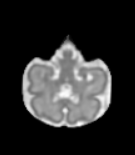
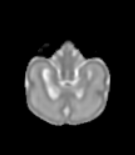
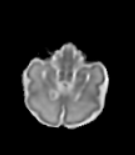
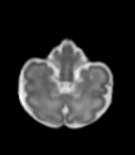
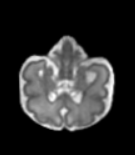
...
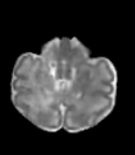
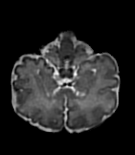
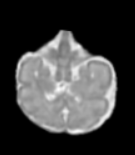
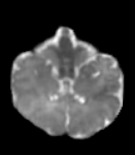
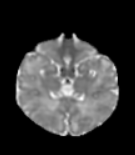

In [1224]:
trace_train = go.Box(
    x=df_age.loc[df_age['type']=='train', 'age'],
    y=df_age.loc[df_age['type']=='train', 'loss'],
    name='train',
    boxpoints='outliers',
    marker = dict(color = 'rgba(141,160,203,.5)', opacity=.5),
    line=dict(width=1)
)
trace_validation = go.Box(
    x=df_age.loc[df_age['type']=='validation', 'age'],
    y=df_age.loc[df_age['type']=='validation', 'loss'],
    name='validation',
    boxpoints='outliers',
    marker = dict(color = 'rgba(102,194,165,.5)', opacity=.5),
    line=dict(width=1)
)
trace_test = go.Box(
    x=df_age.loc[df_age['type']=='test', 'age'],
    y=df_age.loc[df_age['type']=='test', 'loss'],
    name='test',
    boxpoints='outliers',
    marker = dict(color = 'rgba(252,141,98,.5)', opacity=.5),
    line=dict(width=1)
)
layout = go.Layout(
    xaxis=dict(
#         title='gestation age',
        zeroline=False,
        tickmode='linear',
        ticklen=75,
        position=0, tickcolor="#fff"
    ),
    yaxis=dict(
        title='squared error',
        zeroline=False,
        ticksuffix='&deg;'
    ),
    boxmode='group',
    legend=dict(orientation='h', x=.62, y=1.05),
    images= [dict(
        source= np_to_pil(sitk.GetArrayFromImage(sitk.ReadImage(df_age.loc[df_age['age']==str(age), 'path'].tolist()[0]))[:, 100, :]),
        xref= "paper",
        yref= "paper",
        x= -2.12+age/12.2,
        y= -0.25,
        sizex= 0.3,
        sizey= 0.25,
        xanchor= "left",
        yanchor= "bottom",
        name= age
      ) for age in range(26, 38)],
    annotations=[
        dict(
            x=0.5,
            y=-0.45,
            showarrow=False,
            text='gestation age (in weeks)',
            xref='paper',
            yref='paper',
            font=dict(family='Menlo, monospace', size=18)
        )],
    margin = {'r': 0, 't': 0, 'b': 200},
    font=dict(
            family='Menlo, monospace', 
              size=18, 
#               color='#7f7f7f'
             )
)
traces = [trace_validation, trace_test, trace_train]
fig = go.Figure(data=traces, layout=layout)
iplot(fig)

In [1034]:
from PIL import Image
image = sitk.GetArrayFromImage(sitk.ReadImage(df_age.loc[df_age['age']==str(26), 'path'].tolist()[0]))[:, 100, :]
def np_to_pil(image):
    img = np.array(image)
    mean = 0
    # var = 0.1
    # sigma = var**0.5
    gauss = np.random.normal(mean, 1, img.shape)

    # normalize image to range [0,255]
    noisy = img + gauss
    minv = np.amin(noisy)
    maxv = np.amax(noisy)
    noisy = (255 * (noisy - minv) / (maxv - minv)).astype(np.uint8)

    return Image.fromarray(noisy)

(98, 109, 93)


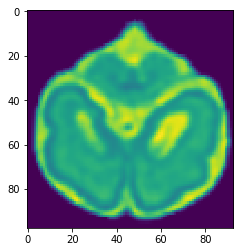

In [1035]:
import nibabel as nib
import nilearn.image as nil_image
def auto_crop(image):
    """Loads data.
    """
    nifti_img = nib.Nifti1Image(image, affine=np.eye(4))
    image_croped = nil_image.crop_img(nifti_img)

    volume = image_croped.get_data()

    return volume
img = auto_crop(sitk.GetArrayFromImage(sitk.ReadImage(df_age.loc[df_age['age']==str(26), 'path'].tolist()[0])))
print(img.shape)
plt.imshow(img[:, 70, :])

## Volunteer data

In [1071]:
def load_volunteer_data(path='../../volunteer_data/data'):
    files = os.listdir(path)
    data = np.zeros((len(files), 300, 6))
    for i, file_name in enumerate(files):
        with open(os.path.join(path, file_name)) as f:
            for j, line in enumerate(f):
#                 print(line, line.rstrip("\n").split("\t\t"))
                for k, param in enumerate(line.rstrip("\n").split("\t\t")):
                    data[i,j,k] = float(param)
#                 data[i,j] = np.fromstring(line.rstrip("\n"), dtype=np.float, sep='\t\t' )
    return data              

In [1072]:
load_volunteer_data().shape

(10, 300, 6)

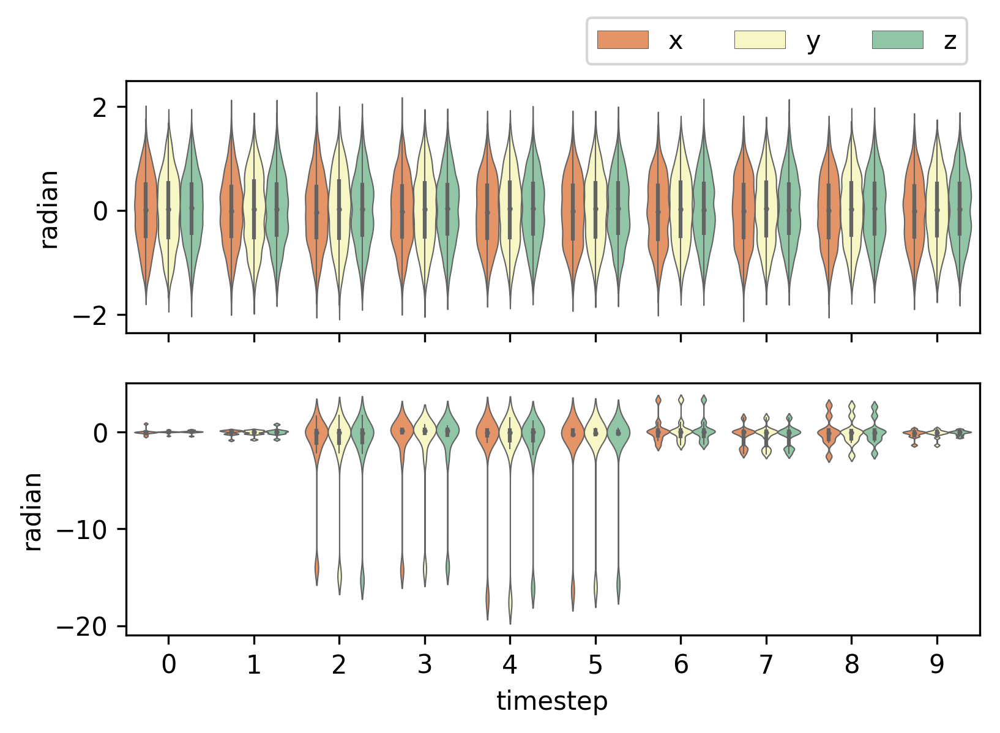

In [1073]:
df_data = []
path = '../../volunteer_data/data'
angle_enum = {0:'x', 1:'y', 2:'z'}
files = os.listdir(path)
for sample, file_name in enumerate(files):
    with open(os.path.join(path, file_name)) as f:
        for timestep, line in enumerate(f):
            for param_idx, param in enumerate(line.rstrip("\n").split("\t\t")):
                if param_idx > 2 and timestep%5==0 and timestep<50:
                    df_data.append((sample, timestep//5, angle_enum[param_idx%3], float(param)))

df = pd.DataFrame(df_data, columns=["sample", "timestep", "angle", "value"])
# df.head()
fig, (ax1, ax2) = plt.subplots(2, sharex=True, dpi=300)
sns.violinplot('timestep', 'value', hue='angle', data=df, palette="Spectral", scale='count', 
               linewidth=.5, scale_hue=False, bw=.2, ax=ax2)
df_data = []
test_angles = np.concatenate((test_y['estimation_rotation_xy'], test_y['estimation_rotation_z']), axis=2)
for sample in range(test_angles.shape[0]):
    for timestep in range(test_angles.shape[1]):
        for angle in range(test_angles.shape[2]):
            df_data.append((sample, timestep, angle_enum[angle], test_angles[sample, timestep, angle]))
df = pd.DataFrame(df_data, columns=["sample", "timestep", "angle", "value"])
sns.violinplot('timestep', 'value', hue='angle', data=df, palette="Spectral", scale='count', 
               linewidth=.5, scale_hue=False, bw=.2, ax=ax1)
ax1.set_ylabel("radian")
ax2.set_ylabel("radian")
ax1.set_xlabel('')
ax1.set_xticks([])
ax2.set_xticks(range(10))
ax2.get_legend().remove()
l = ax1.legend(loc='upper right', bbox_to_anchor=(1, 1.3), ncol=3)
# plt.savefig('data_dist.png', bbox_inches='tight', dpi=300)


In [1083]:
def generate_img_angle_volunteer(timestep, image, angle_offsets, rotation_matrix_init, 
                                 initial_offset=70, timestep_spacing=5):
    rotation_matrix_mov = create_rotation_matrix(angle_offsets)
    rotation_matrix = np.matmul(rotation_matrix_mov, rotation_matrix_init)

    center_idx = np.asanyarray(image.GetSize())/2.
    rotation_center = image.TransformContinuousIndexToPhysicalPoint(center_idx)

    transformation = sitk.VersorRigid3DTransform()
    transformation.SetMatrix(rotation_matrix.ravel())
    transformation.SetCenter(rotation_center)
    transformedImg = sitk.Resample(image, transformation)
    img = sitk.GetArrayFromImage(transformedImg)
    
    vector = vrrotmat2vec(rotation_matrix)
    rotational_offsets = vec5_to_vec3(vector)
    z_offset = initial_offset+timestep*timestep_spacing
    return img[:, z_offset, :], rotational_offsets, z_offset


def gen_data_volunteer(path=TEST_DATA_PATH, sampling_ratio=1.0, files=None, mask=True, shuffle=False,
                         nb_timesteps_est=10, nb_timesteps_pred=10, teacher_force=False, 
                         batch_size=1, h=155, w=135, timestep_spacing=5):

    if not files: 
        files = os.listdir(path)
    nb_files = len(files)
    trajectories = load_volunteer_data()
    nb_samples = trajectories.shape[0]
    imgs = np.zeros([nb_files*nb_samples, nb_timesteps_est, h, w, NB_CHANNELS])
    rotational = np.zeros([nb_files*nb_samples, nb_timesteps_est + nb_timesteps_pred, NB_ANGLES])  
    offset = np.zeros([nb_files*nb_samples, nb_timesteps_est + nb_timesteps_pred, 1])  
    masked, unmasked = 0, 0
    for counter, file_name in enumerate(tqdm(files)):
        image = sitk.ReadImage(path + file_name)

        # There are 10 volunteers, so we apply their motion to each of our own patients
        for i in range(nb_samples): 
            _, _, _, rotation_matrix_init = get_rotational_spline_generators(nb_timesteps_est + nb_timesteps_pred, 
                                                                             speed=4)
            for timestep in range(nb_timesteps_est + nb_timesteps_pred):
                z = trajectories[i, timestep, 2]
                angle_offsets = trajectories[i, timestep*timestep_spacing, 3:]
                img, angle_offsets, _ = generate_img_angle_volunteer(timestep, 
                                                                     image, 
                                                                     angle_offsets, 
                                                                     rotation_matrix_init)
                rotational[nb_samples*counter+i, timestep, :] = angle_offsets   
                offset[nb_samples*counter+i, timestep, 0] = z
                if timestep < nb_timesteps_est:
                    if h == 128:
                        img = cv.resize(img, dsize=(h, w), interpolation=cv.INTER_NEAREST)
                    # randomly mask a timestep with all black image
                    if timestep == timestep_to_mask:
                        img = np.zeros((resize_dim, resize_dim)) # sp_noise(img,0.15)
                    
                    imgs[nb_samples*counter+i, timestep, :, :, 0] = whitening(img)
            
    encoder_input = np.zeros((imgs.shape[0], nb_timesteps_est, imgs.shape[2], imgs.shape[3], NB_CHANNELS))
    decoder_input = np.zeros((imgs.shape[0], nb_timesteps_pred, NB_ANGLES+1))
    encoder_estimation_offset_z = np.zeros((imgs.shape[0], nb_timesteps_est, 1))
    encoder_estimation_rotation_xy = np.zeros((imgs.shape[0], nb_timesteps_est, 2))
    encoder_estimation_rotation_z = np.zeros((imgs.shape[0], nb_timesteps_est, 1))
    decoder_prediction_offset_z = np.zeros((imgs.shape[0], nb_timesteps_pred, 1))
    decoder_prediction_rotation_xy = np.zeros((imgs.shape[0], nb_timesteps_pred, 2))
    decoder_prediction_rotation_z = np.zeros((imgs.shape[0], nb_timesteps_pred, 1))
    for i in range(imgs.shape[0]):
        encoder_input[i, :nb_timesteps_est] = imgs[i, :nb_timesteps_est]

        encoder_estimation_rotation_xy[i] = rotational[i, :nb_timesteps_est, :2]               
        decoder_prediction_rotation_xy[i] = rotational[i, nb_timesteps_est:, :2]       
        encoder_estimation_rotation_z[i] = rotational[i, :nb_timesteps_est, 2:]  
        decoder_prediction_rotation_z[i] = rotational[i, nb_timesteps_est:, 2:]        
        encoder_estimation_offset_z[i] = offset[i, :nb_timesteps_est]
        decoder_prediction_offset_z[i] = offset[i, nb_timesteps_est:] 

        # help decoder by showing current input
        if teacher_force:
            decoder_input[i, :nb_timesteps_est] = rotational[i, nb_timesteps_est:]

    x = {"encoder_input": encoder_input, "decoder_input": decoder_input}
    y = {"estimation_offset_z": encoder_estimation_offset_z, 
         "estimation_rotation_xy": encoder_estimation_rotation_xy,
         "estimation_rotation_z": encoder_estimation_rotation_z,
         "prediction_offset_z": decoder_prediction_offset_z, 
         "prediction_rotation_xy": decoder_prediction_rotation_xy,
         "prediction_rotation_z": decoder_prediction_rotation_z}
    return x, y

In [1084]:
train_volnteer_X, train_volnteer_y = gen_data_volunteer(path=TRAIN_DATA_PATH, h=155, w=135)
test_volnteer_X, test_volnteer_y = gen_data_volunteer(path=TEST_DATA_PATH, h=155, w=135)

HBox(children=(IntProgress(value=0, max=36), HTML(value='')))

HBox(children=(IntProgress(value=0, max=40), HTML(value='')))

In [1087]:
test_volnteer_X_128 = resize_to_NxN(test_volnteer_X)

In [1090]:
our_model_volnteer_pred = our_model.predict(test_volnteer_X_128)

In [1121]:
df_volnteer_our_model_pred = pd.DataFrame(np.concatenate(((test_volnteer_y['prediction_rotation_z'] - our_model_volnteer_pred[5])**2,
                                                          (test_volnteer_y['prediction_rotation_xy'] - our_model_volnteer_pred[4])**2),
                                            axis=2).sum(axis=2), 
                       columns=list(range(10))).melt()
df_volnteer_our_model_pred.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [1091]:
dlstm_volnteer_pred = dLSTM.predict(test_volnteer_X)

In [1122]:
df_volnteer_dlstm_pred = pd.DataFrame(np.concatenate(((test_volnteer_y['prediction_rotation_z'] - dlstm_volnteer_pred[5])**2,
                                                      (test_volnteer_y['prediction_rotation_xy'] - dlstm_volnteer_pred[4])**2),
                                            axis=2).sum(axis=2), 
                                       columns=list(range(10))).melt()
df_volnteer_dlstm_pred.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [1130]:
# Zero Velocity Baseline for Volunteer
volnteer_total_samples, volnteer_timesteps = test_volnteer_y['estimation_rotation_z'].shape[0], test_volnteer_y['estimation_rotation_z'].shape[1]

df_volnteer_zvb_pred = pd.DataFrame(np.concatenate(((test_volnteer_y['prediction_rotation_xy'][:, :, :] - 
                                                     train_volnteer_y['estimation_rotation_xy'][:, 9, :].mean(axis=0))**2,
                                                    (test_volnteer_y['prediction_rotation_z'][:, :, :] - 
                                                     train_volnteer_y['estimation_rotation_z'][:, 9, :].mean(axis=0))**2),
                                                         axis=2).sum(axis=2), 
                       columns=list(range(10))).melt()
df_volnteer_zvb_pred.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [1132]:
# Code for Auto regressive baseline
# Load image -> generate samples for estimation -> take first prediction and generate image -> feed back to model
volnteer_nb_samples, volnteer_timesteps, h, w, chanel = test_volnteer_X_128['encoder_input'].shape
volnteer_ar_loss = np.zeros((volnteer_nb_samples, volnteer_timesteps)) 

volnteer_est_nb_timesteps, volnteer_pred_nb_timesteps = volnteer_timesteps, volnteer_timesteps
volnteer_total_timesteps = volnteer_est_nb_timesteps + volnteer_pred_nb_timesteps

volnteer_encoder_input = np.zeros((test_volnteer_X_128['encoder_input'].shape[0], volnteer_total_timesteps, h, w, chanel))
volnteer_encoder_input[:, :volnteer_est_nb_timesteps, :] = test_volnteer_X_128['encoder_input']
volnteer_decoder_input = test_volnteer_X_128['decoder_input']
for i in tqdm(range(volnteer_nb_samples)):
    if i%40 == 0:
        image = sitk.ReadImage(TEST_DATA_PATH + test_files[i%40])
    # e.g. 10 pred timesteps, rest are offset by est_nb_timesteps + current_timestep-> 10, 11, ..
    for timestep in range(volnteer_pred_nb_timesteps):
        prediction = our_model.predict({"encoder_input": volnteer_encoder_input[i:i+1, timestep:volnteer_est_nb_timesteps+timestep], 
                                        "decoder_input": volnteer_decoder_input[i:i+1]})
        volnteer_pred_angles = np.concatenate((prediction[4][:, 0, :], prediction[5][:, 0, :]), axis=1)[0]
        volnteer_gt_angles = np.concatenate((test_volnteer_y['prediction_rotation_xy'][i, 0, :], 
                                             test_volnteer_y['prediction_rotation_z'][i, 0, :]))
        volnteer_ar_loss[i, timestep] = ((volnteer_gt_angles - volnteer_pred_angles)**2).sum(axis=0)

        if timestep < pred_nb_timesteps - 1:
            img = generate_img_from_angle(image, volnteer_est_nb_timesteps + timestep + 1, volnteer_pred_angles, pred=False)
            encoder_input[i, volnteer_est_nb_timesteps + timestep + 1, :] = img.reshape((h, w, chanel))

HBox(children=(IntProgress(value=0, max=400), HTML(value='')))

In [1126]:
df_volnteer_ar_pred = pd.DataFrame(volnteer_ar_loss, columns=list(range(volnteer_timesteps))).melt()
df_volnteer_ar_pred.rename(index=str, columns={'variable': 'timestep', 'value':'loss'}, inplace=True)

In [1138]:
trace_volnteer_om = go.Box(
    x=df_volnteer_our_model_pred['timestep']+10,
    y=df_volnteer_our_model_pred['loss'],
    name='Our model',
    boxpoints='outliers',
    marker = dict(color = 'rgba(44, 160, 101, 0.5)', opacity=.5),#636EFA
    line=dict(width=1)
)
trace_volnteer_dlstm = go.Box(
    x=df_volnteer_dlstm_pred['timestep']+10,
    y=df_volnteer_dlstm_pred['loss'],
    name='directLSTM',
    boxpoints='outliers',
    marker = dict(color = 'rgba(93, 164, 214, 0.5)', opacity=.5),
    line=dict(width=1)
)
trace_volnteer_zvb = go.Box(
    x=df_volnteer_zvb_pred['timestep']+10,
    y=df_volnteer_zvb_pred['loss'],
    name='Zero Velocity',
    boxpoints='outliers',
    marker = dict(color = 'rgba(207, 114, 255, 0.5)', opacity=.5),
    line=dict(width=1)
)
trace_volnteer_ar = go.Box(
    x=df_volnteer_ar_pred['timestep']+10,
    y=df_volnteer_ar_pred['loss'],
    name='Auto Regressive',
    boxpoints='outliers',
    marker = dict(color = 'rgba(255, 150, 12, 0.5)', opacity=.5),
    line=dict(width=1)
)

layout = go.Layout(
    xaxis=dict(
        title='timestep',
        zeroline=False,
        tickmode='linear'
    ),
    yaxis=dict(
        title='squared error',
        zeroline=False,
        ticksuffix='&deg;'
    ),
    margin = {'r': 0, 't': 0, 'b': 50},
    boxmode='group',
#     legend=dict(orientation='v', x=.87, y=.97)
    legend=dict(orientation='h', x=0.23, y=1.05),    
    font=dict(
            family='Menlo, monospace', 
              size=18, 
#               color='#7f7f7f'
             )
)
traces = [
        trace_volnteer_om,
        trace_volnteer_zvb,
        trace_volnteer_ar,
        trace_volnteer_dlstm
]
fig = go.Figure(data=traces, layout=layout)
iplot(fig)

---

# Minimum steps needed for prediction

In [220]:
loss_estimation_offset_z = np.zeros(10)
loss_estimation_rotation_xy = np.zeros(10)
loss_estimation_rotation_z = np.zeros(10)
for i in range(10):
    loss_estimation_offset_z[i] = calculate_mse(test_y['estimation_offset_z'][:, i, :], model_prediction[0][:, i, :])
    loss_estimation_rotation_xy[i] = calculate_mse(test_y['estimation_rotation_xy'][:, i, :], model_prediction[1][:, i, :])
    loss_estimation_rotation_z[i] = calculate_mse(test_y['estimation_rotation_z'][:, i, :], model_prediction[2][:, i, :])

In [221]:
loss_prediction_offset_z = np.zeros(10)
loss_prediction_rotation_xy = np.zeros(10)
loss_prediction_rotation_z = np.zeros(10)
for i in range(10):
    loss_prediction_offset_z[i] = calculate_mse(test_y['prediction_offset_z'][:, i, :], model_prediction[3][:, i, :])
    loss_prediction_rotation_xy[i] = calculate_mse(test_y['prediction_rotation_xy'][:, i, :], model_prediction[4][:, i, :])
    loss_prediction_rotation_z[i] = calculate_mse(test_y['prediction_rotation_z'][:, i, :], model_prediction[5][:, i, :])

In [115]:
maps = sorted(
    m for m in plt.cm.cmap_d
    if not m.endswith("_r") and  # Skip reversed colormaps.
    not m.startswith(('spectral', 'Vega'))  # Skip deprecated colormaps.
)

In [158]:
test_X_est3_pred17['encoder_input'].shape

(1280, 3, 155, 135, 1)

In [174]:
est_timesteps, pred_timesteps = 3, 17
# test_X_est3_pred17, test_y_est3_pred17 = data_generation(path=TEST_DATA_PATH, files=test_files,
#                                                         est_nb_timesteps=est_timesteps, 
#                                                             pred_nb_timesteps=pred_timesteps)
# model_est3_pred17 = load_model("../models/ourModel_pred_est3pred17", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
# s = model_est3_pred17.predict(resize_to_NxN(test_X_est3_pred17))
total_samples = test_X_est3_pred17['encoder_input'].shape[0]
loss_estimation_offset_z = np.zeros((total_samples, est_timesteps))
loss_estimation_rotation_xy = np.zeros((total_samples, est_timesteps))
loss_estimation_rotation_z = np.zeros((total_samples, est_timesteps))
for i in range(3):
    loss_estimation_offset_z[:, i] = ((test_y_est3_pred17['estimation_offset_z'][:, i, :] - s[0][:, i, :])**2).reshape(total_samples)
    loss_estimation_rotation_xy[:, i] = ((test_y_est3_pred17['estimation_rotation_xy'][:, i, :] - s[1][:, i, :])**2).mean(axis=1)
    loss_estimation_rotation_z[:, i] = ((test_y_est3_pred17['estimation_rotation_z'][:, i, :] - s[2][:, i, :])**2).reshape(total_samples)

loss_prediction_offset_z = np.zeros((total_samples, pred_timesteps))
loss_prediction_rotation_xy = np.zeros((total_samples, pred_timesteps))
loss_prediction_rotation_z = np.zeros((total_samples, pred_timesteps))
for i in range(17):
    loss_prediction_offset_z[:, i] = ((test_y_est3_pred17['prediction_offset_z'][:, i, :] - s[3][:, i, :])**2).reshape(total_samples)
    loss_prediction_rotation_xy[:, i] = ((test_y_est3_pred17['prediction_rotation_xy'][:, i, :] - s[4][:, i, :])**2).mean(axis=1)
    loss_prediction_rotation_z[:, i] = ((test_y_est3_pred17['prediction_rotation_z'][:, i, :] - s[5][:, i, :])**2).reshape(total_samples)

In [230]:
est_timesteps, pred_timesteps = 3, 17
# test_X_est3_pred17, test_y_est3_pred17 = data_generation(path=TEST_DATA_PATH, files=test_files,
#                                                         est_nb_timesteps=est_timesteps, 
#                                                             pred_nb_timesteps=pred_timesteps)
# model_est3_pred17 = load_model("../models/ourModel_pred_est3pred17", custom_objects={'PReLU': PReLU, 'Pitanh': Pitanh})
# s = model_est3_pred17.predict(resize_to_NxN(test_X_est3_pred17))
total_samples = test_X_est3_pred17['encoder_input'].shape[0]
loss_offset_z = np.zeros((total_samples, est_timesteps + pred_timesteps))
loss_rotation_xy = np.zeros((total_samples, est_timesteps + pred_timesteps))
loss_rotation_z = np.zeros((total_samples, est_timesteps + pred_timesteps))
for i in range(3):
    loss_offset_z[:, i] = ((test_y_est3_pred17['estimation_offset_z'][:, i, :] - s[0][:, i, :])**2).reshape(total_samples)
    loss_rotation_xy[:, i] = ((test_y_est3_pred17['estimation_rotation_xy'][:, i, :] - s[1][:, i, :])**2).mean(axis=1)
    loss_rotation_z[:, i] = ((test_y_est3_pred17['estimation_rotation_z'][:, i, :] - s[2][:, i, :])**2).reshape(total_samples)

for i in range(17):
    loss_offset_z[:, 3+i] = ((test_y_est3_pred17['prediction_offset_z'][:, i, :] - s[3][:, i, :])**2).reshape(total_samples)
    loss_rotation_xy[:, 3+i] = ((test_y_est3_pred17['prediction_rotation_xy'][:, i, :] - s[4][:, i, :])**2).mean(axis=1)
    loss_rotation_z[:, 3+i] = ((test_y_est3_pred17['prediction_rotation_z'][:, i, :] - s[5][:, i, :])**2).reshape(total_samples)

In [231]:
df_est3_pred17 = pd.DataFrame(loss_offset_z, 
                              columns=list(range(est_timesteps + pred_timesteps))).melt()

df_est3_pred17.rename(index=str, columns={'variable': 'timestep', 'value':'t_z'}, inplace=True)

df_est3_pred17['theta_xy'] = loss_rotation_xy.reshape((total_samples*(est_timesteps + pred_timesteps)))
df_est3_pred17['theta_z'] = loss_rotation_z.reshape((total_samples*(est_timesteps + pred_timesteps)))

In [232]:
df_est3_pred17.head()

,timestep,t_z,theta_xy,theta_z
0,0,0.000004,0.000073,0.001775
1,0,0.000848,0.002189,0.000383
2,0,0.000011,0.012583,0.004354
3,0,0.000016,0.067343,0.047048
4,0,0.000801,0.049003,0.014820


In [1147]:
import colorlover as cl
from IPython.display import HTML

In [1174]:
HTML(cl.to_html( cl.scales['9']['div'] ))


In [1157]:
HTML(cl.to_html( cl.scales['3']['seq'] ))

In [1176]:
colors = cl.to_numeric(cl.scales['3']['seq']['YlOrBr'])
colors

[(255.0, 247.0, 188.0), (254.0, 196.0, 79.0), (217.0, 95.0, 14.0)]

In [1178]:
trace0 = go.Box(
    x=df_est3_pred17['timestep'],
    y=df_est3_pred17['t_z'],
    name='$t_z$',
    boxpoints='outliers',
    marker = dict(color = 'rgba(254.0, 196.0, 79.0, .5)', opacity=.5), # 'rgba(44, 160, 101, 0.5)'
    line=dict(width=1)
)
trace1 = go.Box(
    x=df_est3_pred17['timestep'],
    y=df_est3_pred17['theta_xy'],
    name=r'$\theta_{xy}$',
    boxpoints='outliers',
    marker = dict(color = 'rgba(158.0, 188.0, 218.0, .5)', opacity=.5), # 'rgba(93, 164, 214, 0.5)'
    line=dict(width=1)
)
trace2 = go.Box(
    x=df_est3_pred17['timestep'],
    y=df_est3_pred17['theta_z'],
    name=r'$\theta_z$',
    boxpoints='outliers',
    marker = dict(color = 'rgba(136.0, 86.0, 167.0, .5)', opacity=.5), # 'rgba(255, 144, 14, 0.5)'
    line=dict(width=1)
)

trace3 = go.Scatter(
    x=[0.9, 4.2],
    y=[-0.4, -0.4],
    text=["Estimation",
          "Prediction"],
    mode="text",
    showlegend=False
)

layout = go.Layout(
    xaxis=dict(
        title='timestep',
        zeroline=False,
        tickmode='linear'
    ),
    yaxis=dict(
        title='squared error',
        zeroline=False,
        ticksuffix='&deg;'
    ),
    margin = {'r': 0, 't': 50, 'b': 50},
    boxmode='group',
    legend=dict(orientation='h', x=.80, y=.97),    
    font=dict(
            family='Menlo, monospace', 
              size=18, 
#               color='#7f7f7f'
             ),
    shapes=[

    #Line reference to the axes
        go.layout.Shape(
            type="line",
            x0=0,
            y0=-0.2,
            x1=2,
            y1=-0.2,
            line=dict(
                color='#998ec3',#"#f1a340",
                width=2,
                dash="solid",
            ),
        ),
        go.layout.Shape(
            type="line",
            x0=3,
            y0=-0.2,
            x1=19,
            y1=-0.2,
            line=dict(
                color='#5ab4ac',#"#998ec3",
                width=2,
                dash="solid",
            ),
        )
    ]
)
traces = [
          trace0, 
          trace1, 
          trace2,
            trace3
]
fig = go.Figure(data=traces, layout=layout)
iplot(fig)

## Create "prediction" models

When using the encoder-decoder to predict a sequence of arbitrary length, the encoder first encodes the entire input sequence. The state of the encoder is then fed to the decoder which then produces the output sequence sequentially.
Although a new model is being created with the keras.models.Model class, the input and output tensors of the model are the same as those used during training, hence the weights of the layers applied to the tensors are preserved.

As you will see, creating the prediction models also gives the ability to inspect the state of the model at different points throughout the prediction process. 
* We could study how the encoder creates a representation of the input data. For instance, how does the model represent the offset? 
* Or the frequency? 
* Does it decompose the signal into it's constituent angles signal and represent them as different dimensions of the state vector? 
These are very interesting questions for another time.

In [61]:
# Let's define a small function that predicts based on the trained encoder and decoder models

def predict_future(x, encoder_predict_model, decoder_predict_model, num_steps_to_predict=10):
    """Predict time series with encoder-decoder.
    
    Uses the encoder and decoder models previously trained to predict the next
    num_steps_to_predict values of the time series.
    
    Arguments
    ---------
    x: input time series of shape (batch_size, input_sequence_length, input_dimension).
    encoder_predict_model: The Keras encoder model.
    decoder_predict_model: The Keras decoder model.
    num_steps_to_predict: The number of steps in the future to predict
    
    Returns
    -------
    y_predicted: output time series for shape (batch_size, target_sequence_length,
        ouput_dimension)
    """
    y_predicted = []

    # Encode the values as a state vector
    states = encoder_predict_model.predict(x)

    # The states must be a list
    if not isinstance(states, list):
        states = [states]

    # Generate first value of the decoder input sequence
    decoder_input = np.zeros((x.shape[0], 1, NB_ANGLES))


    for _ in range(num_steps_to_predict):
        outputs_and_states = decoder_predict_model.predict([decoder_input] + states, batch_size=1)
        output, states = outputs_and_states[0], outputs_and_states[1:]

        # add predicted value
        y_predicted.append(output)

    return np.concatenate(y_predicted, axis=1)
    

In [101]:
decoder_predict_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
decoder_input (InputLayer)      (None, None, 3)      0                                            
__________________________________________________________________________________________________
input_1 (InputLayer)            (None, 512)          0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, 512)          0                                            
__________________________________________________________________________________________________
decoder_rnn (CuDNNLSTM)         [(None, None, 512),  1058816     decoder_input[0][0]              
                                                                 input_1[0][0]                    
          

In [439]:
X, y = gen_data(speed=8, nb_samples=1)

HBox(children=(IntProgress(value=0, max=40), HTML(value='')))

# Total samples: 40 each with 5 timesteps
(40, 5, 128, 128, 1) (40, 10, 3)


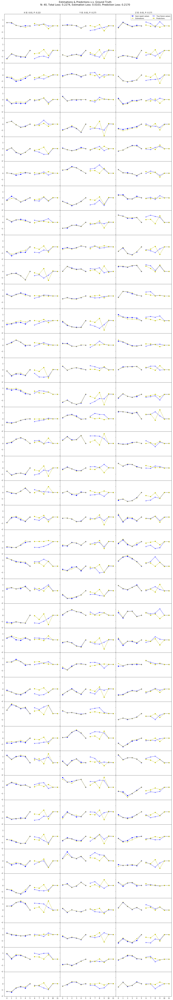

In [57]:
plot_prediction(X, y, annotate_individual_angles=False)

In [443]:
y = predict_future(X["encoder_input"], encoder_predict_model, decoder_predict_model, num_steps_to_predict=15)
plot_prediction(X, y, annotate_individual_angles=False)

ValueError: Error when checking model target: the list of Numpy arrays that you are passing to your model is not the size the model expected. Expected to see 2 array(s), but instead got the following list of 1 arrays: [array([[[-0.23199086, -0.04883059, -0.3016111 ],
        [-0.17147131,  0.04134681, -0.23405981],
        [ 0.12726268, -0.06702171, -0.07943913],
        ..., 
        [ 0.09410592,  0.17298397,  0....

In [178]:
X, y, labels = gen_data(n=nb_train_files, path=TRAIN_DATA_PATH, files=train_files, nb_timesteps=10, speed=6)

HBox(children=(IntProgress(value=0, max=36), HTML(value='')))

Ratio of unmasked:masked timesteps: 180.0


In [179]:
estimation, prediction = model.predict(X)

In [180]:
total_loss, estimation_loss, prediction_loss = get_loss_with_names(model, X, y)
loss_title = 'N: {}, Total Loss: {:.4f}, Estimation Loss: {:.4f}, Prediction Loss: {:.4f}'.format(
    estimation.shape[0], total_loss[1], estimation_loss[1], prediction_loss[1])

In [183]:
prediction_1 = predict_future(X["encoder_input"], encoder_predict_model, decoder_predict_model, num_steps_to_predict=15)
plot_prediction(labels, estimation, prediction_1, loss_title)

TypeError: __index__ returned non-int (type NoneType)

## t-SNE embedding of LSTM cell + output state

In [18]:
from matplotlib.image import BboxImage
from matplotlib.transforms import Bbox, TransformedBbox
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from cycler import cycler

In [19]:
from matplotlib import cm

In [20]:
def show_grid(X):  
    fig = plt.figure(figsize=(30,30))
    for i in range(X.shape[0]):
        ax = fig.add_subplot(4, 5, i+1)
        ax.text(.1, .9, i, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
        ax.imshow(X[i].reshape((155,135)), cmap='gray', interpolation='nearest')
        ax.axis('off')
        ax.grid(True)
    
#     plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)
    plt.subplots_adjust(wspace=0.0125, hspace=0.001)
#     plt.suptitle("Timesteps go left -> right, top -> down", fontsize=24)
    plt.show()

In [21]:
X, y = data_generation(path=TEST_DATA_PATH, files=test_files, speeds=[8], 
                       est_nb_timesteps=10, pred_nb_timesteps=0, h=128, w=128, mask=True)
X['encoder_input'].shape

HBox(children=(IntProgress(value=0, max=40), HTML(value='')))

(40, 10, 128, 128, 1)

In [22]:
N = X['encoder_input'].shape[0]

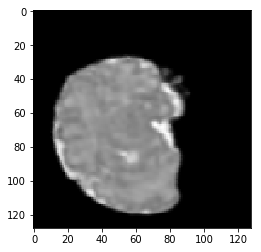

In [23]:
sample_img = X['encoder_input'][1, 0].reshape((128, 128))
plt.imshow(sample_img, cmap='gray')

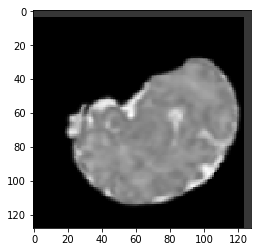

In [1235]:
rows,cols = sample_img.shape
M = np.float32([[1,0,-4],[0,1,4]])
dst = cv.warpAffine(sample_img,M,(cols,rows))
plt.imshow(dst, cmap='gray')

In [147]:
%matplotlib inline

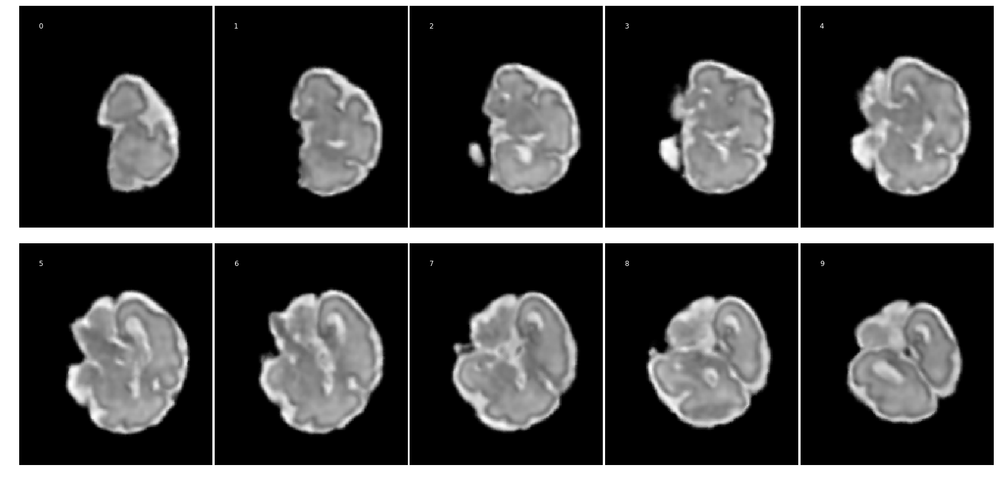

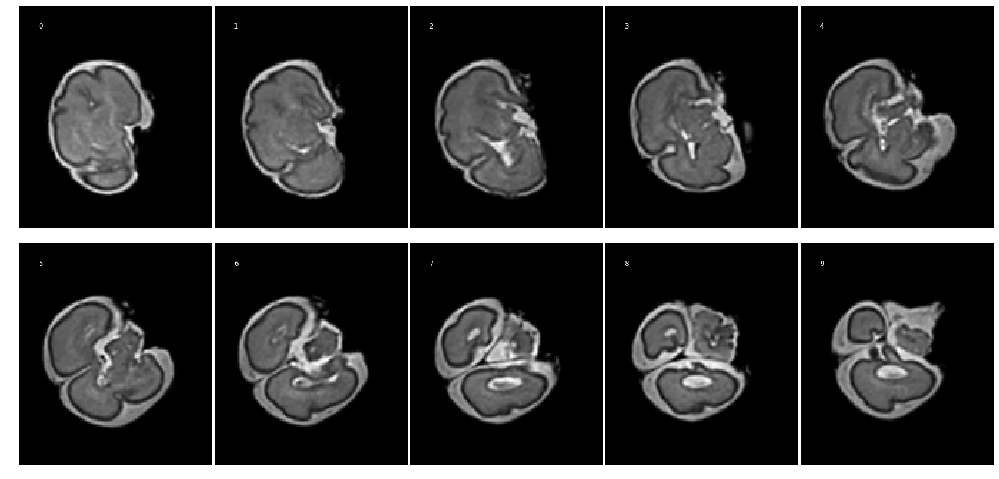

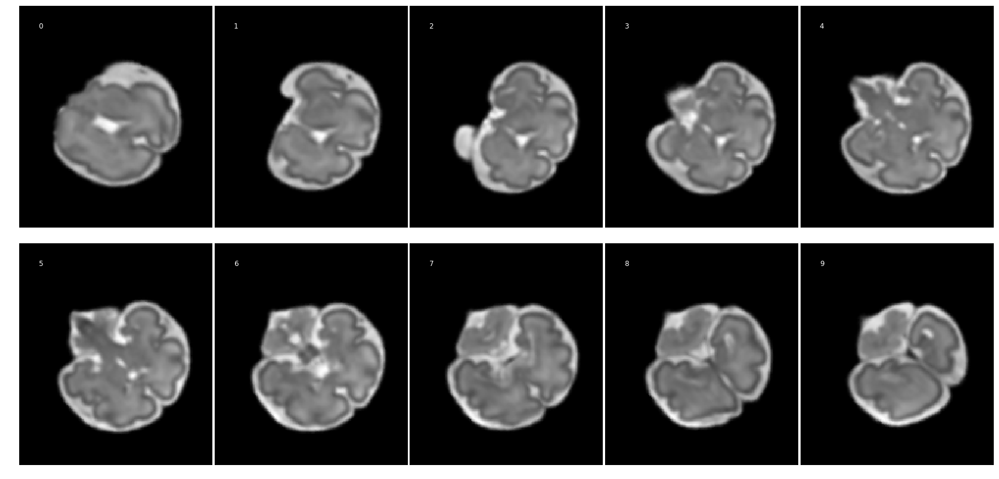

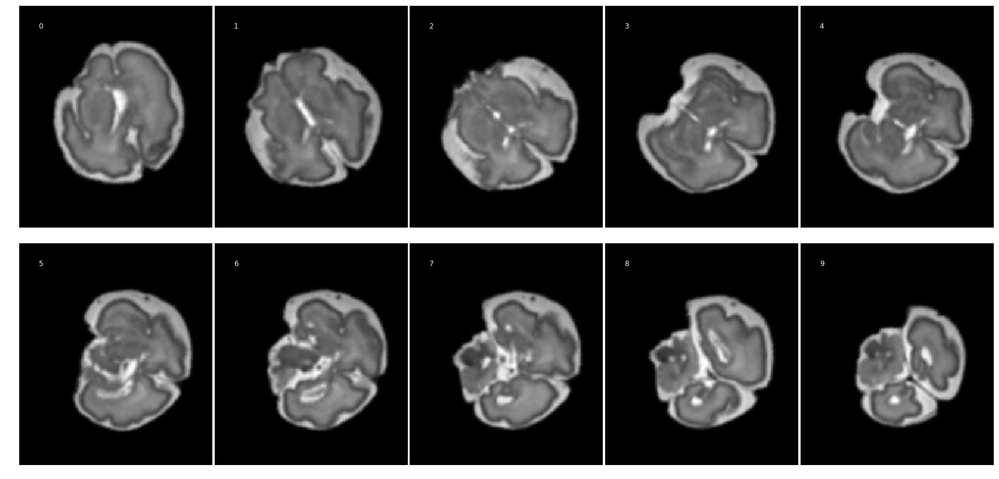

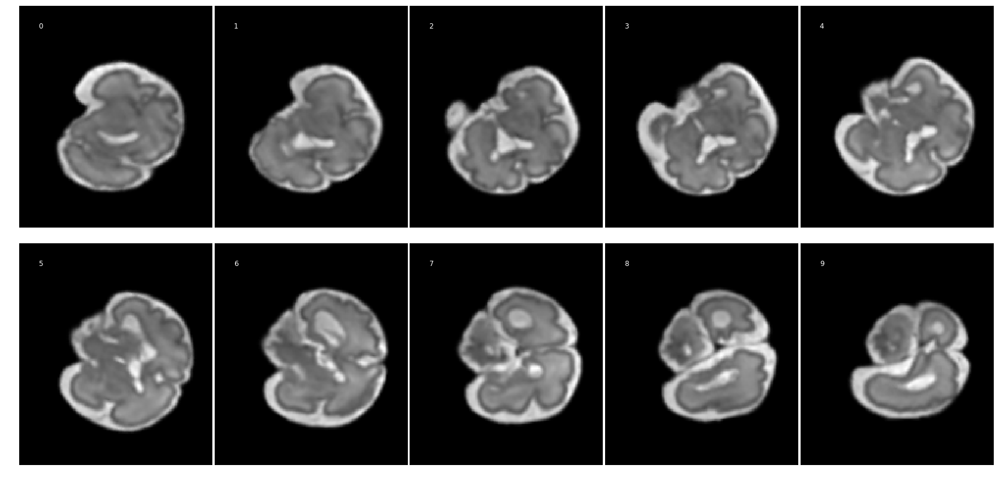

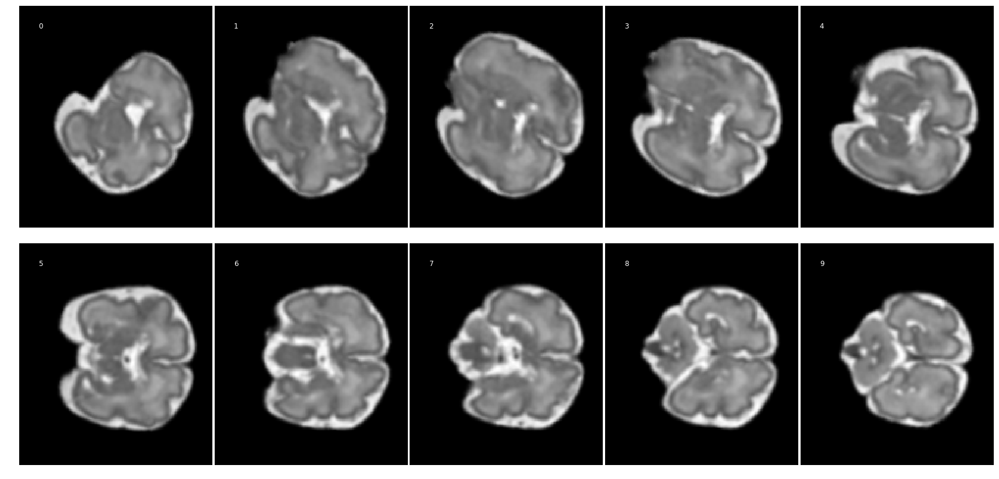

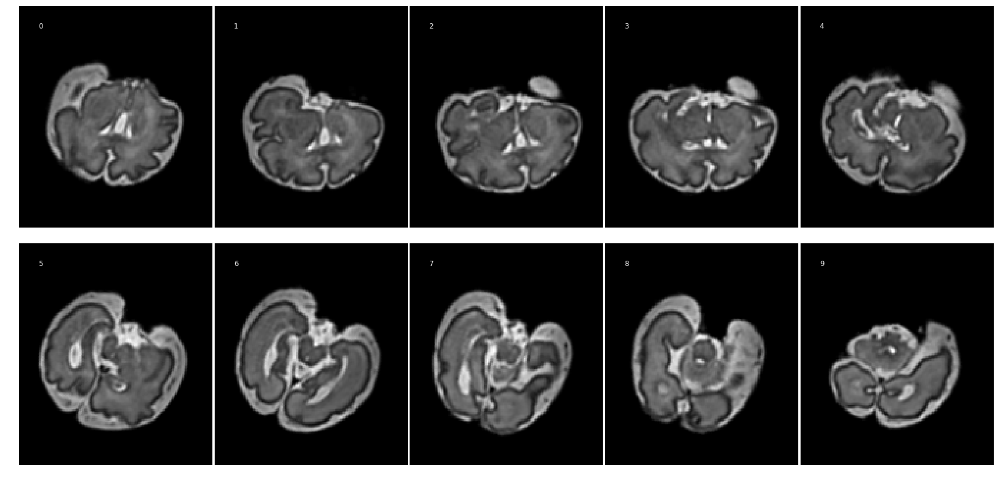

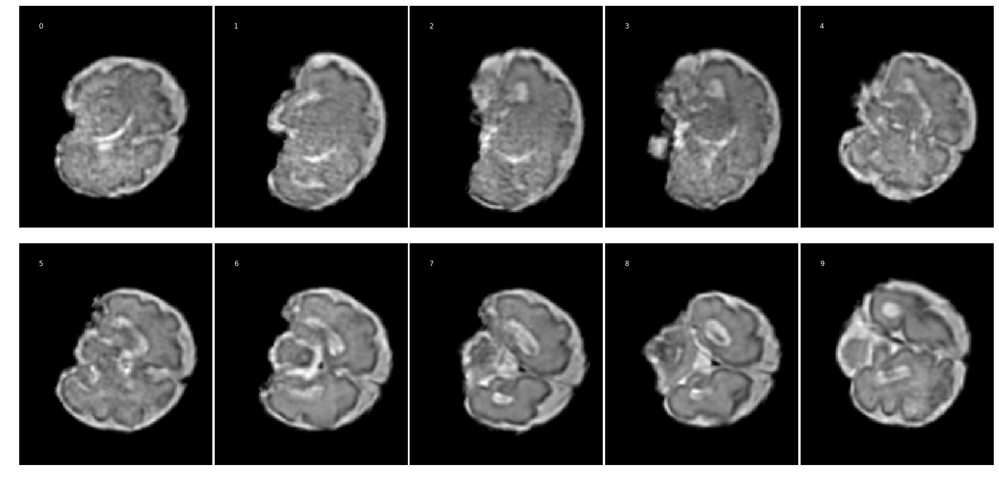

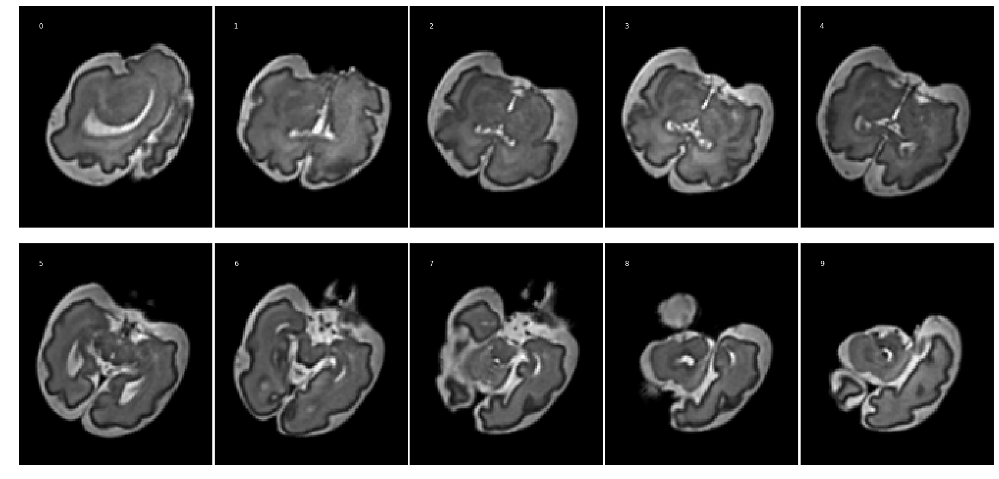

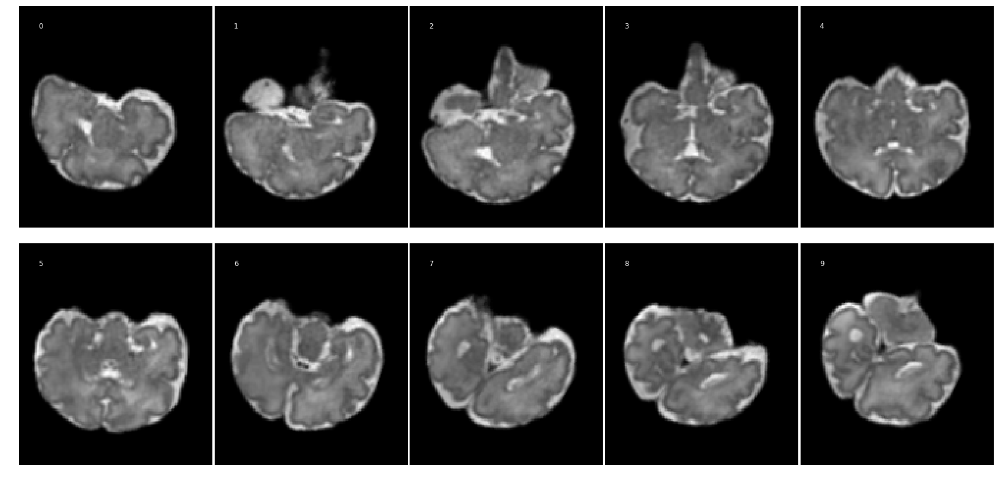

In [121]:
for i in range(10):
    show_grid(X['encoder_input'][i])

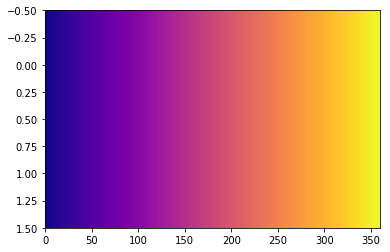

In [1225]:
gradient = np.linspace(0, 1, 360)
gradient = np.vstack((gradient, gradient))
name = 'plasma'
plt.imshow(gradient, aspect='auto', cmap=plt.get_cmap(name))

In [133]:
%matplotlib inline

In [131]:
import seaborn as sns

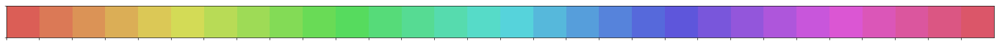

In [132]:
NUM_COLORS = sequences.shape[0]
sns.palplot(sns.color_palette("hls", NUM_COLORS))

In [24]:
encoder_tsne_model = Model(our_model.inputs, our_model.get_layer("encoder_rnn").output)

In [25]:
output = encoder_tsne_model.predict(X)
encoder_outputs, encoder_states = output[0], output[1:]
sequences = encoder_outputs
encoder_outputs.shape, sequences.shape

((40, 10, 512), (40, 10, 512))

In [26]:
encoder_states[0].shape

(40, 512)

In [27]:
# seqs_reshaped = np.mean(encoder_states, axis=0)
seqs_reshaped = sequences.reshape((sequences.shape[0]*sequences.shape[1], 512))
seqs_reshaped.shape

(400, 512)

In [28]:
# To make sure reshaping went fine
np.subtract(sequences[0, :5], seqs_reshaped[:5])

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]], dtype=float32)

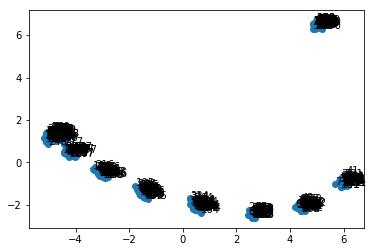

In [29]:
lstm_embedded = PCA(n_components=2).fit_transform(seqs_reshaped)
fig, ax = plt.subplots()
for i in range(lstm_embedded.shape[0]):
    ax.annotate(i, (lstm_embedded[i, 0], lstm_embedded[i, 1]))
ax.scatter(lstm_embedded[:, 0], lstm_embedded[:, 1])

In [30]:
lstm_pca = PCA(n_components=50).fit_transform(seqs_reshaped)
lstm_pca.shape

(400, 50)

Number of colors 40


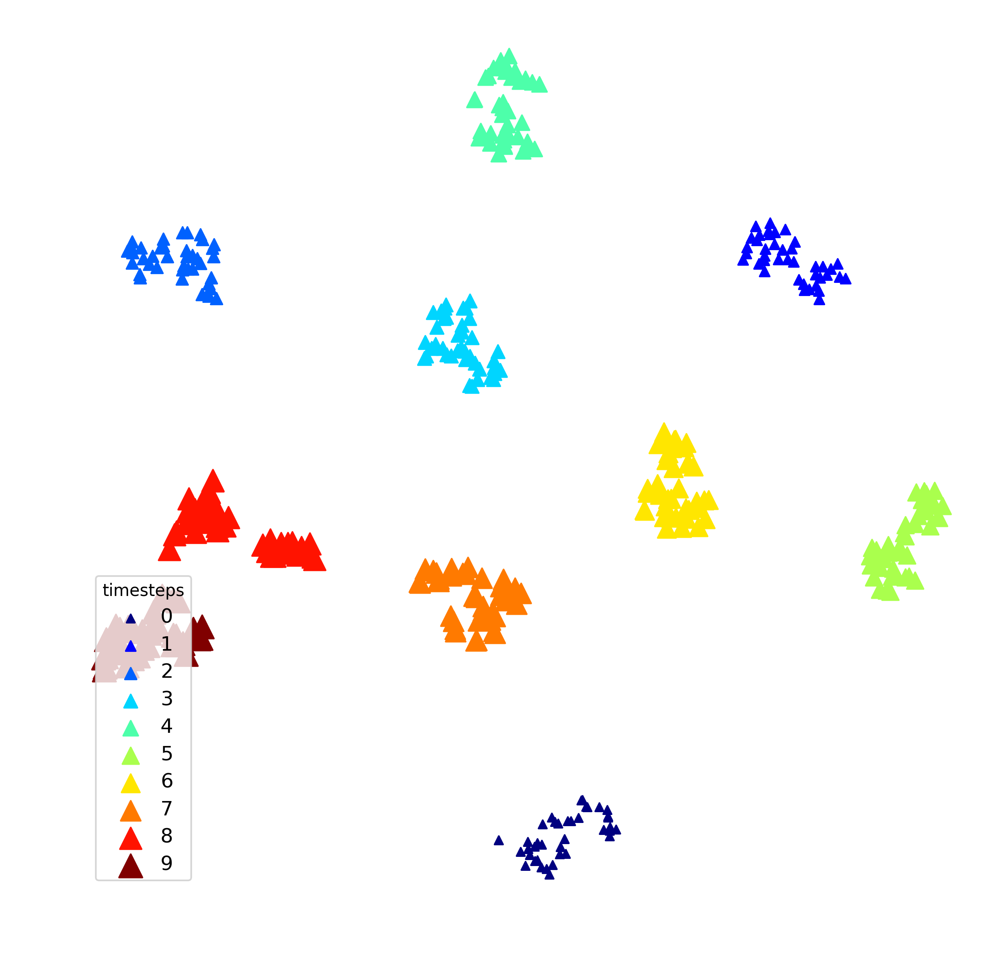

In [31]:
lstm_embedded = TSNE(learning_rate=200, perplexity=10).fit_transform(seqs_reshaped)

fig, ax = plt.subplots(dpi=300, figsize=(10,10)) #figsize=(10,10) , 
ax.set_axis_off()
# plt.axis("off")
# maps = sorted(
#     m for m in plt.cm.cmap_d
#     if not m.endswith("_r") and  # Skip reversed colormaps.
#     not m.startswith(('spectral', 'Vega'))  # Skip deprecated colormaps.
# )
# markers = ['o', '^', 's', '.', ',', 'v', '<', '>', '1', '2']
NUM_COLORS = sequences.shape[0]
print("Number of colors", NUM_COLORS)
cmap = plt.get_cmap('plasma')
cmap = plt.get_cmap('jet')
colors = [cmap(i) for i in np.linspace(0, 1, sequences.shape[1])]

for i in range(9, lstm_embedded.shape[0]):
#     ax.annotate(i%sequences.shape[1], (lstm_embedded[i, 0], lstm_embedded[i, 1]))
    ax.scatter(lstm_embedded[i, 0], lstm_embedded[i, 1], 
               s=(i%sequences.shape[1] + 5)**2,
               c=colors[i%sequences.shape[1]], marker='^')

for i in range(sequences.shape[1]):
#     ax.annotate(i%sequences.shape[1], (lstm_embedded[i, 0], lstm_embedded[i, 1]))
    ax.scatter(lstm_embedded[i, 0], lstm_embedded[i, 1], 
               s=(i%sequences.shape[0] + 5)**2, marker='^', 
               label=i%sequences.shape[1], c=colors[i%sequences.shape[1]])        

leg = ax.legend(loc=(.04,.04), title='timesteps')  # 'lower left'
_ = plt.setp(leg.get_texts(), fontsize='12')
# ax.set_prop_cycle(cycler(color=[cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]))
# ax.scatter(lstm_embedded[:, 0], lstm_embedded[:, 1], c=colors, m=maps)
# fig.savefig('../imgs/tsne_lstm_output_ids_perplexity30.png', format='png', dpi=300, bbox_inches='tight')

just to avoid accidently hitting execute on this cell

Number of colors 36


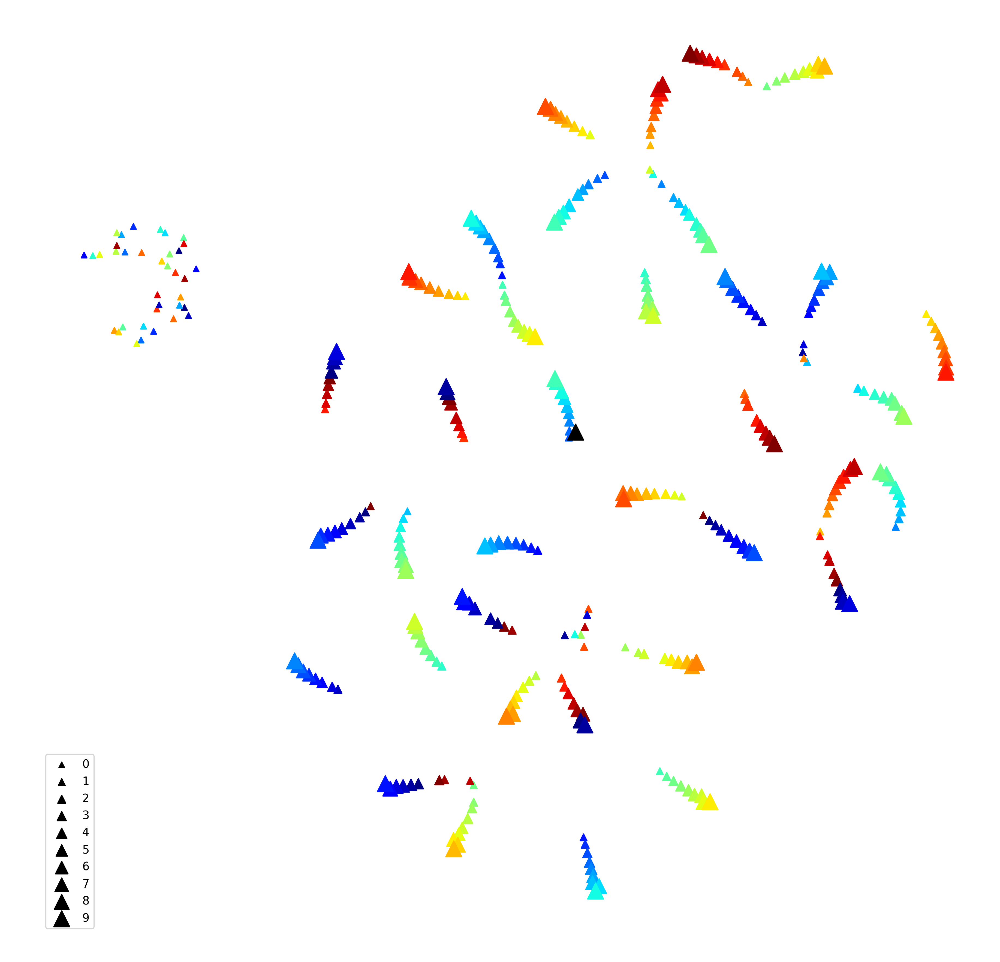

In [202]:
# The original plot posted in paper
fig, ax = plt.subplots(dpi=300, figsize=(15,15)) #figsize=(10,10) , 
ax.set_axis_off()
# plt.axis("off")
# maps = sorted(
#     m for m in plt.cm.cmap_d
#     if not m.endswith("_r") and  # Skip reversed colormaps.
#     not m.startswith(('spectral', 'Vega'))  # Skip deprecated colormaps.
# )
# markers = ['o', '^', 's', '.', ',', 'v', '<', '>', '1', '2']
NUM_COLORS = sequences.shape[0]
print("Number of colors", NUM_COLORS)
cmap = plt.get_cmap('jet')
colors = [cmap(i) for i in np.linspace(0, 1, NUM_COLORS)]
cm = plt.get_cmap('plasma')
for i in range(lstm_embedded.shape[0]):
#     ax.annotate(i, (lstm_embedded[i, 0], lstm_embedded[i, 1]))
#     ax.annotate(i, (lstm_embedded[i, 0]-2, lstm_embedded[i, 1]-2))
    ax.scatter(lstm_embedded[i, 0], lstm_embedded[i, 1], s=(i%sequences.shape[1] + 5)**2,
               c=colors[i%NUM_COLORS], marker='^')
#     , marker=markers[i//10])
#     bb = Bbox.from_bounds(lstm_embedded[i, 0], lstm_embedded[i, 1],3,3)  
#     bb2 = TransformedBbox(bb,ax.transData)
#     bbox_image = BboxImage(bb2, cmap=plt.get_cmap(cm),
#                         norm=None,
#                         origin=None,
#                         clip_on=False)
#     bbox_image.set_data(X['encoder_input'][i//10, i%10, :, :, 0])
#     ax.add_artist(bbox_image)


for i in range(10):
#     ax.annotate(i, (lstm_embedded[i, 0], lstm_embedded[i, 1]))
#     ax.annotate(i, (lstm_embedded[i, 0]-2, lstm_embedded[i, 1]-2))
    ax.scatter(0,0, s=(i%sequences.shape[1] + 5)**2, marker='^', label=i%NUM_COLORS, c='black')
ax.legend(loc='lower left')

# ax.set_prop_cycle(cycler(color=[cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]))
# ax.scatter(lstm_embedded[:, 0], lstm_embedded[:, 1], c=colors, m=maps)
fig.savefig('../imgs/tsne_lstm_states_ids_perplexity5_square_x.png', format='png', dpi=300, bbox_inches='tight')

## Repeat the same with decoder LSTM states

In [32]:
our_model.get_layer("decoder_rnn").output

[<tf.Tensor 'decoder_rnn/transpose_1:0' shape=(?, ?, 512) dtype=float32>,
 <tf.Tensor 'decoder_rnn/strided_slice_16:0' shape=(?, 512) dtype=float32>,
 <tf.Tensor 'decoder_rnn/strided_slice_17:0' shape=(?, 512) dtype=float32>]

In [39]:
decoder_tsne_model = Model(our_model.inputs, our_model.get_layer("encoder_rnn").output + 
                                              our_model.get_layer("decoder_rnn").output)

In [ ]:
decoder_tsne_model.compile(loss='mse', optimizer='rmsprop')
decoder_tsne_model.output_shape

In [ ]:
decoder_output = decoder_tsne_model.predict(X)
decoder_outputs, decoder_states = decoder_output[0], decoder_output[1:]
decoder_sequences = decoder_outputs
decoder_outputs.shape, decoder_sequences.shape

In [1]:
decoder_states[0].shape

NameError: name 'decoder_states' is not defined

In [1240]:
# seqs_reshaped = np.mean(encoder_states, axis=0)
seqs_reshaped = sequences.reshape((sequences.shape[0]*sequences.shape[1], 512))
seqs_reshaped.shape

(400, 512)

In [1241]:
# To make sure reshaping went fine
np.subtract(sequences[0, :5], seqs_reshaped[:5])

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]], dtype=float32)

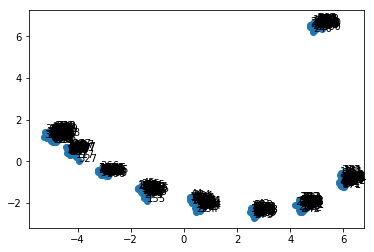

In [1242]:
lstm_embedded = PCA(n_components=2).fit_transform(seqs_reshaped)
fig, ax = plt.subplots()
for i in range(lstm_embedded.shape[0]):
    ax.annotate(i, (lstm_embedded[i, 0], lstm_embedded[i, 1]))
ax.scatter(lstm_embedded[:, 0], lstm_embedded[:, 1])

In [1243]:
lstm_pca = PCA(n_components=50).fit_transform(seqs_reshaped)
lstm_pca.shape

(400, 50)

Number of colors 40


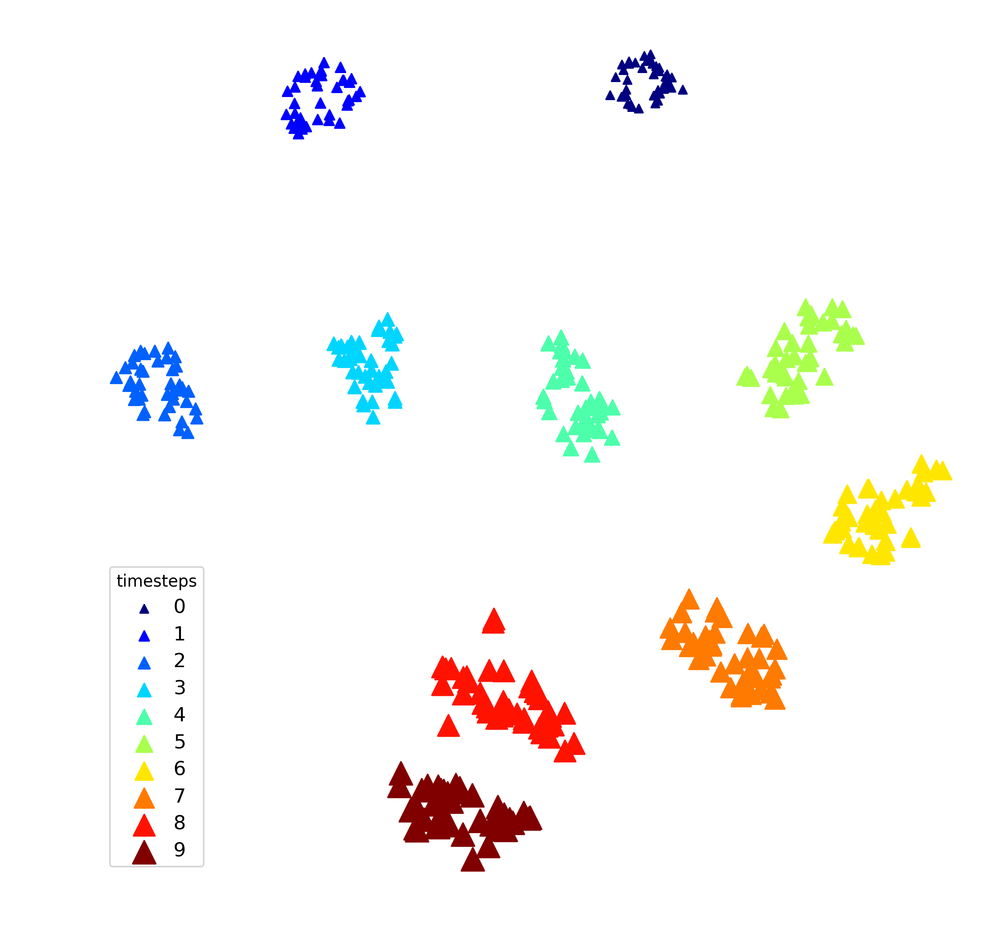

In [1277]:
lstm_embedded = TSNE(learning_rate=.1, perplexity=40).fit_transform(seqs_reshaped)

fig, ax = plt.subplots(dpi=300, figsize=(10,10)) #figsize=(10,10) , 
ax.set_axis_off()
# plt.axis("off")
# maps = sorted(
#     m for m in plt.cm.cmap_d
#     if not m.endswith("_r") and  # Skip reversed colormaps.
#     not m.startswith(('spectral', 'Vega'))  # Skip deprecated colormaps.
# )
# markers = ['o', '^', 's', '.', ',', 'v', '<', '>', '1', '2']
NUM_COLORS = sequences.shape[0]
print("Number of colors", NUM_COLORS)
cmap = plt.get_cmap('plasma')
cmap = plt.get_cmap('jet')
colors = [cmap(i) for i in np.linspace(0, 1, sequences.shape[1])]

for i in range(9, lstm_embedded.shape[0]):
#     ax.annotate(i%sequences.shape[1], (lstm_embedded[i, 0], lstm_embedded[i, 1]))
    ax.scatter(lstm_embedded[i, 0], lstm_embedded[i, 1], 
               s=(i%sequences.shape[1] + 5)**2,
               c=colors[i%sequences.shape[1]], marker='^')

for i in range(sequences.shape[1]):
#     ax.annotate(i%sequences.shape[1], (lstm_embedded[i, 0], lstm_embedded[i, 1]))
    ax.scatter(lstm_embedded[i, 0], lstm_embedded[i, 1], 
               s=(i%sequences.shape[0] + 5)**2, marker='^', 
               label=i%sequences.shape[1], c=colors[i%sequences.shape[1]])        

leg = ax.legend(loc=(.04,.04), title='timesteps')  # 'lower left'
_ = plt.setp(leg.get_texts(), fontsize='12')
# ax.set_prop_cycle(cycler(color=[cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]))
# ax.scatter(lstm_embedded[:, 0], lstm_embedded[:, 1], c=colors, m=maps)
# fig.savefig('../imgs/tsne_lstm_output_ids_perplexity30.png', format='png', dpi=300, bbox_inches='tight')

### See if different speed clustered together

In [184]:
lstm_embedded = TSNE(learning_rate=100, perplexity=10).fit_transform(lstm_pca)

In [201]:
sequences.shape

(30, 10, 512)

Number of colors 5


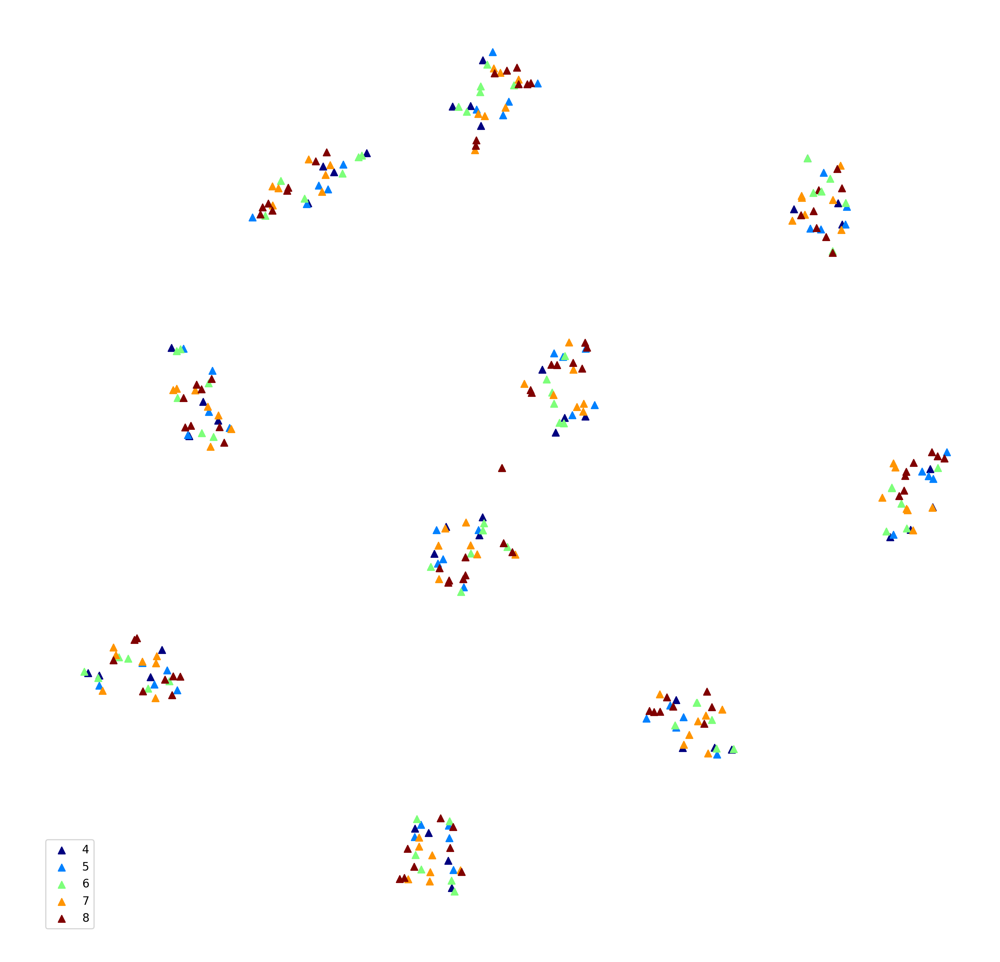

In [205]:
# See if different speed clustered together
fig, ax = plt.subplots(dpi=300, figsize=(15,15)) #figsize=(10,10) , 
ax.set_axis_off()
# plt.axis("off")
# maps = sorted(
#     m for m in plt.cm.cmap_d
#     if not m.endswith("_r") and  # Skip reversed colormaps.
#     not m.startswith(('spectral', 'Vega'))  # Skip deprecated colormaps.
# )
# markers = ['o', '^', 's', '.', ',', 'v', '<', '>', '1', '2']
NUM_COLORS = 5
print("Number of colors", NUM_COLORS)
cmap = plt.get_cmap('jet')
colors = [cmap(i) for i in np.linspace(0, 1, NUM_COLORS)]
cm = plt.get_cmap('plasma')
for i in range(lstm_embedded.shape[0]):
#     ax.annotate(i, (lstm_embedded[i, 0], lstm_embedded[i, 1]))
#     ax.annotate(i, (lstm_embedded[i, 0]-2, lstm_embedded[i, 1]-2))
    for j, rang in enumerate([(0,40),(40,90),(90,150),(150,220),(220,300)]):
        if rang[0] < i < rang[1]:
            color = colors[j]
            break
    ax.scatter(lstm_embedded[i, 0], lstm_embedded[i, 1], 
#                s=(i%sequences.shape[1] + 5)**2,
               c=color, marker='^')
#     , marker=markers[i//10])
#     bb = Bbox.from_bounds(lstm_embedded[i, 0], lstm_embedded[i, 1],3,3)  
#     bb2 = TransformedBbox(bb,ax.transData)
#     bbox_image = BboxImage(bb2, cmap=plt.get_cmap(cm),
#                         norm=None,
#                         origin=None,
#                         clip_on=False)
#     bbox_image.set_data(X['encoder_input'][i//10, i%10, :, :, 0])
#     ax.add_artist(bbox_image)


for i, speed in enumerate(range(4,9)):      
    ax.scatter(0,0, 
#                s=(i%sequences.shape[1] + 5)**2, 
               marker='^', label=speed, c=colors[i])
ax.legend(loc='lower left')

# ax.set_prop_cycle(cycler(color=[cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]))
# ax.scatter(lstm_embedded[:, 0], lstm_embedded[:, 1], c=colors, m=maps)
# fig.savefig('../imgs/tsne_lstm_states_ids_perplexity5_square_x.png', format='png', dpi=300, bbox_inches='tight')

## Impose predicted angles on images

In [34]:
[(sh, name) for sh, name in zip(model.output_shape, model.output_names)]

[((None, None, 1), 'estimation_offset_z'),
 ((None, None, 2), 'estimation_rotation_xy'),
 ((None, None, 1), 'estimation_rotation_z'),
 ((None, None, 1), 'prediction_offset_z'),
 ((None, None, 2), 'prediction_rotation_xy'),
 ((None, None, 1), 'prediction_rotation_z')]

In [50]:
imgs.shape

(5, 10, 128, 128, 1)

In [56]:
est_nb_timesteps=10
pred_nb_timesteps=10
mask, teacher_force = False, False
path=TRAIN_DATA_PATH
resize_dim = 128
files = train_files[29:30]
speeds = [4,5,6,7,8]
nb_samples = len(speeds)
nb_files = len(files)
imgs = np.zeros([nb_files*nb_samples, est_nb_timesteps, 128, 128, 1])
rotational = np.zeros([nb_files*nb_samples, est_nb_timesteps + pred_nb_timesteps, NB_ANGLES])  
offset = np.zeros([nb_files*nb_samples, est_nb_timesteps + pred_nb_timesteps, NB_CHANNELS])
for counter, file_name in enumerate(tqdm(files)):
    image = sitk.ReadImage(path + file_name)
    for i in range(nb_samples):
        ius_x, ius_y, ius_z, rotation_matrix_init = get_rotational_spline_generators(est_nb_timesteps + pred_nb_timesteps, speed=speeds[i])
        timestep_to_mask = np.random.randint(low=0, high=est_nb_timesteps, size=1)[0] if mask else est_nb_timesteps + 1

        for timestep in range(est_nb_timesteps + pred_nb_timesteps):
            z = 70+timestep*5
            img, angle_offsets = generate_img_angle(timestep, 
                                                    image, 
                                                    ius_x, ius_y, ius_z, 
                                                    rotation_matrix_init)
            rotational[nb_samples*counter+i, timestep, :] = angle_offsets

            offset[nb_samples*counter+i, timestep, 0] = z
            if timestep < est_nb_timesteps:
                rescaled_resized_img = cv.resize(img, dsize=(resize_dim, resize_dim), interpolation=cv.INTER_NEAREST)
                # randomly mask a timestep with all black image
                if timestep == timestep_to_mask:
                    rescaled_resized_img = sp_noise(img,0.15) # np.zeros((resize_dim, resize_dim))

                imgs[nb_samples*counter+i, timestep, :, :, 0] = whitening(rescaled_resized_img)

encoder_input = np.zeros((imgs.shape[0], est_nb_timesteps, imgs.shape[2], imgs.shape[3], NB_CHANNELS))
decoder_input = np.zeros((imgs.shape[0], pred_nb_timesteps, NB_ANGLES+1))
encoder_estimation_offset_z = np.zeros((imgs.shape[0], est_nb_timesteps, 1))
encoder_estimation_rotation_xy = np.zeros((imgs.shape[0], est_nb_timesteps, 2))
encoder_estimation_rotation_z = np.zeros((imgs.shape[0], est_nb_timesteps, 1))
decoder_prediction_offset_z = np.zeros((imgs.shape[0], pred_nb_timesteps, 1))
decoder_prediction_rotation_xy = np.zeros((imgs.shape[0], pred_nb_timesteps, 2))
decoder_prediction_rotation_z = np.zeros((imgs.shape[0], pred_nb_timesteps, 1))
for i in range(imgs.shape[0]):
    encoder_input[i, :est_nb_timesteps] = imgs[i, :est_nb_timesteps]

    encoder_estimation_rotation_xy[i] = rotational[i, :est_nb_timesteps, :2]               
    decoder_prediction_rotation_xy[i] = rotational[i, est_nb_timesteps:, :2]       
    encoder_estimation_rotation_z[i] = rotational[i, :est_nb_timesteps, 2:]  
    decoder_prediction_rotation_z[i] = rotational[i, est_nb_timesteps:, 2:]        
    encoder_estimation_offset_z[i] = offset[i, :est_nb_timesteps]
    decoder_prediction_offset_z[i] = offset[i, est_nb_timesteps:] 

    # help decoder by showing current input
    if teacher_force:
        decoder_input[i, :est_nb_timesteps] = rotational[i, est_nb_timesteps:]

x = {"encoder_input": encoder_input, "decoder_input": decoder_input}
y = {"estimation_offset_z": encoder_estimation_offset_z, 
     "estimation_rotation_xy": encoder_estimation_rotation_xy,
     "estimation_rotation_z": encoder_estimation_rotation_z,
     "prediction_offset_z": decoder_prediction_offset_z, 
     "prediction_rotation_xy": decoder_prediction_rotation_xy,
     "prediction_rotation_z": decoder_prediction_rotation_z}

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

In [58]:
x_pred = model.predict(x)

In [60]:
model.evaluate(x, y)

1/1 [==============================] - 0s 7ms/step


[0.32253748178482056,
 0.0016934650484472513,
 0.0025772687513381243,
 0.0033697255421429873,
 0.00086627865675836802,
 0.18486467003822327,
 0.12916606664657593]

In [61]:
def generate_img_from_angle(image, timestep, angles, pred=False):
    rotation_matrix = create_rotation_matrix(angles)
    #rotation_matrix = np.matmul(rotation_matrix_mov, rotation_matrix_init)

    center_idx = np.asanyarray(image.GetSize())/2.
    rotation_center = image.TransformContinuousIndexToPhysicalPoint(center_idx)
    
    transformation = sitk.VersorRigid3DTransform()
    transformation.SetMatrix(rotation_matrix.ravel())
    transformation.SetCenter(rotation_center)

    transformedImg = sitk.Resample(image, transformation)
    img = sitk.GetArrayFromImage(transformedImg)
    
    return img[:, int(timestep.round()), :] if pred else img[:, 70+timestep*5, :]

In [64]:
y['estimation_rotation_xy'][0,0].shape

(2,)

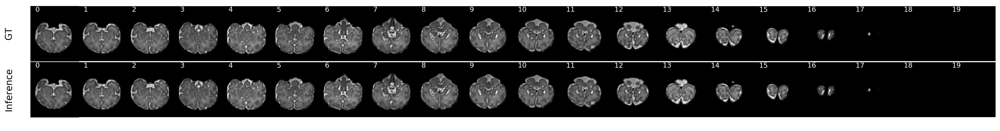

In [73]:
fig = plt.figure(figsize=(30,3.6), dpi=300)

for i in range(10):
    ax = fig.add_subplot(2, 20, i+1)
    ax.text(.1, .9, i, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
    imx = generate_img_from_angle(image, i, 
                    np.concatenate((y['estimation_rotation_xy'][0, i, :], y['estimation_rotation_z'][0, i, :])))
    ax.imshow(imx, cmap='gray', interpolation='nearest')
    if i ==0:
        ax.axis('on')    
        ax.set_ylabel('GT', fontdict={'size':16})
        ax.grid(False)
        ax.tick_params(labelcolor='w', top=False, bottom=False, left=False, right=False)
    else:
        ax.axis('off')
        ax.grid(True)

for i in range(10):
    ax = fig.add_subplot(2, 20, i+10+1)
    ax.text(.1, .9, i+10, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
    imx = generate_img_from_angle(image, i+10, 
                    np.concatenate((y['prediction_rotation_xy'][0, i, :], y['prediction_rotation_z'][0, i, :])))
    ax.imshow(imx, cmap='gray', interpolation='nearest')
    ax.axis('off')
    ax.grid(True)


for i in range(10):
    ax = fig.add_subplot(2, 20, i+20+1)
    ax.text(.1, .9, i, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
    imx = generate_img_from_angle(image, x_pred[0][0, i, 0], 
                                np.concatenate((x_pred[1][0, i, :], x_pred[2][0, i, :])), True)
    ax.imshow(imx, cmap='gray', interpolation='nearest')
    if i == 0:
        ax.axis('on')    
        ax.set_ylabel('Inference', fontdict={'size':16})
        ax.grid(False)
        ax.tick_params(labelcolor='w', top=False, bottom=False, left=False, right=False)
    else:
        ax.axis('off')
        ax.grid(True)
      
for i in range(10):
    ax = fig.add_subplot(2, 20, i+30+1)
    ax.text(.1, .9, i+10, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
    imx = generate_img_from_angle(image, x_pred[3][0, i, 0], 
                                np.concatenate((x_pred[4][0, i, :], x_pred[5][0, i, :])), True)
    ax.imshow(imx, cmap='gray', interpolation='nearest')
    ax.axis('off')
    ax.grid(True)

# Set common labels
# fig.text(0.5, 0.04, 'common xlabel', ha='center', va='center')
# fig.text(0.06, 0.5, 'common ylabel', ha='center', va='center', rotation='vertical')    
######### annotating the x axis   #########
# plt.annotate('', xy=(0, 10),xytext=(0,-9),                    
#             arrowprops=dict(arrowstyle='<->',facecolor='red'),   
#             annotation_clip=False)                               

# plt.annotate('estimation',xy=(0,25),xytext=(.5,-.25), annotation_clip=False)


# plt.annotate('', xy=(5, -20),xytext=(5,-20),                   
#             arrowprops=dict(arrowstyle='<->',facecolor='red'),
#             annotation_clip=False)

# plt.annotate('prediction',xy=(5,-250),xytext=(8,-25), annotation_clip=False)
#     plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=None)
plt.subplots_adjust(wspace=0.00125, hspace=0.000)
# plt.suptitle("Timesteps go left -> right, top -> down", fontsize=24)
plt.show()

## Plot speeds on a single subject

In [829]:
y['estimation_rotation_xy'].shape, x['encoder_input'].shape

((5, 10, 2), (5, 10, 128, 128, 1))

In [859]:
imx = sitk.GetArrayFromImage(image)
imx.shape

(155, 189, 135)

In [1181]:
def get_rotational_spline_generators_static_rota_matrix(nb_timesteps, rotation_matrix_init, angle=60, speed=5):
    intra_angle = angle//2
    x = np.linspace(0, nb_timesteps-1, speed)
    yx = np.random.uniform(-intra_angle, intra_angle, speed)
    yy = np.random.uniform(-intra_angle, intra_angle, speed)
    yz = np.random.uniform(-intra_angle, intra_angle, speed)

    ius_x = InterpolatedUnivariateSpline(x, yx)
    ius_y = InterpolatedUnivariateSpline(x, yy)
    ius_z = InterpolatedUnivariateSpline(x, yz)
    
    return ius_x, ius_y, ius_z

In [1180]:
def generate_img_angle_uniangular(timestep, image, ius_x, ius_y, ius_z, rotation_matrix):
    xrot = ius_x(timestep)
    yrot = ius_y(timestep)
    zrot = ius_z(timestep)
    rotation_matrix_mov = create_rotation_matrix([xrot, yrot, zrot])
    rotation_matrix = np.matmul(rotation_matrix_mov, rotation_matrix_init)

    center_idx = np.asanyarray(image.GetSize())/2.
    rotation_center = image.TransformContinuousIndexToPhysicalPoint(center_idx)

    transformation = sitk.VersorRigid3DTransform()
    transformation.SetMatrix(rotation_matrix.ravel())
    transformation.SetCenter(rotation_center)
    transformedImg = sitk.Resample(image, transformation)
    img = sitk.GetArrayFromImage(transformedImg)
    
    vector = vrrotmat2vec(rotation_matrix)
    rotational_offsets = vec5_to_vec3(vector)
    
    return img[:, 70+timestep*5, :], rotational_offsets

In [1192]:
est_nb_timesteps=10
pred_nb_timesteps=10
angle=60
mask, teacher_force = True, False
path=TRAIN_DATA_PATH
resize_dim = 128
files = train_files[29:30]
speeds = [4,5,6,7,8]
nb_samples = len(speeds)
nb_files = len(files)
imgs = np.zeros([nb_files*nb_samples, est_nb_timesteps, 128, 128, 1])
rotational = np.zeros([nb_files*nb_samples, est_nb_timesteps + pred_nb_timesteps, NB_ANGLES])  
offset = np.zeros([nb_files*nb_samples, est_nb_timesteps + pred_nb_timesteps, NB_CHANNELS])
for counter, file_name in enumerate(tqdm(files)):
    image = sitk.ReadImage(path + file_name)
    rotation = np.random.uniform(-angle, angle, 3)
    rotation_matrix_init = create_rotation_matrix(rotation)
    for i in range(nb_samples):
        ius_x, ius_y, ius_z = get_rotational_spline_generators_static_rota_matrix(est_nb_timesteps + pred_nb_timesteps, 
                                                                                   rotation_matrix_init,
                                                                                  speed=speeds[i])
        timestep_to_mask = np.random.randint(low=0, high=est_nb_timesteps, size=1)[0] if mask else est_nb_timesteps + 1

        for timestep in range(est_nb_timesteps + pred_nb_timesteps):
            z = 70+timestep*5
            img, angle_offsets = generate_img_angle_uniangular(timestep, 
                                                    image, 
                                                    ius_x, ius_y, ius_z, 
                                                    rotation_matrix_init)
            rotational[nb_samples*counter+i, timestep, :] = angle_offsets

            offset[nb_samples*counter+i, timestep, 0] = z
            if timestep < est_nb_timesteps:
                # randomly mask a timestep with all black image
                if timestep == timestep_to_mask:
                    img = np.zeros((resize_dim, resize_dim))
#                     img = sp_noise(img,0.15) 
                rescaled_resized_img = cv.resize(img, dsize=(resize_dim, resize_dim), interpolation=cv.INTER_NEAREST)

                imgs[nb_samples*counter+i, timestep, :, :, 0] = whitening(rescaled_resized_img)

encoder_input = np.zeros((imgs.shape[0], est_nb_timesteps, imgs.shape[2], imgs.shape[3], NB_CHANNELS))
decoder_input = np.zeros((imgs.shape[0], pred_nb_timesteps, NB_ANGLES+1))
encoder_estimation_offset_z = np.zeros((imgs.shape[0], est_nb_timesteps, 1))
encoder_estimation_rotation_xy = np.zeros((imgs.shape[0], est_nb_timesteps, 2))
encoder_estimation_rotation_z = np.zeros((imgs.shape[0], est_nb_timesteps, 1))
decoder_prediction_offset_z = np.zeros((imgs.shape[0], pred_nb_timesteps, 1))
decoder_prediction_rotation_xy = np.zeros((imgs.shape[0], pred_nb_timesteps, 2))
decoder_prediction_rotation_z = np.zeros((imgs.shape[0], pred_nb_timesteps, 1))
for i in range(imgs.shape[0]):
    encoder_input[i, :est_nb_timesteps] = imgs[i, :est_nb_timesteps]

    encoder_estimation_rotation_xy[i] = rotational[i, :est_nb_timesteps, :2]               
    decoder_prediction_rotation_xy[i] = rotational[i, est_nb_timesteps:, :2]       
    encoder_estimation_rotation_z[i] = rotational[i, :est_nb_timesteps, 2:]  
    decoder_prediction_rotation_z[i] = rotational[i, est_nb_timesteps:, 2:]        
    encoder_estimation_offset_z[i] = offset[i, :est_nb_timesteps]
    decoder_prediction_offset_z[i] = offset[i, est_nb_timesteps:] 

    # help decoder by showing current input
    if teacher_force:
        decoder_input[i, :est_nb_timesteps] = rotational[i, est_nb_timesteps:]

x = {"encoder_input": encoder_input, "decoder_input": decoder_input}
y = {"estimation_offset_z": encoder_estimation_offset_z, 
     "estimation_rotation_xy": encoder_estimation_rotation_xy,
     "estimation_rotation_z": encoder_estimation_rotation_z,
     "prediction_offset_z": decoder_prediction_offset_z, 
     "prediction_rotation_xy": decoder_prediction_rotation_xy,
     "prediction_rotation_z": decoder_prediction_rotation_z}

HBox(children=(IntProgress(value=0, max=1), HTML(value='')))

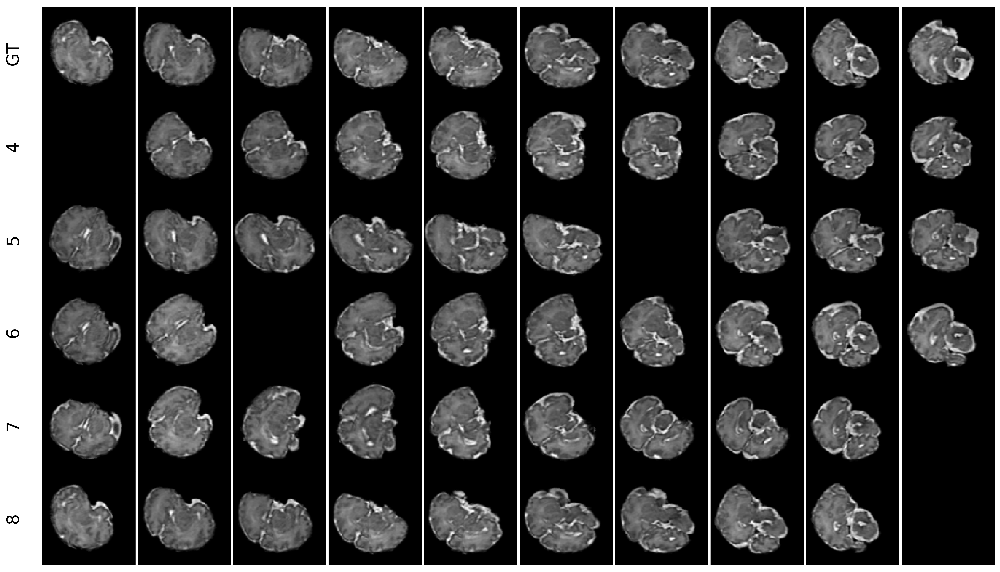

In [1193]:
fig = plt.figure(figsize=(25,15), dpi=300)
imx = sitk.GetArrayFromImage(image)
font_size = 25
for timestep in range(10):
        ax = fig.add_subplot(6, 10, timestep+1)
#         ax.text(.1, .9, speed, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
    #     imx = generate_img_from_angle(image, i, 
    #                     np.concatenate((y['estimation_rotation_xy'][i, 0], y['estimation_rotation_z'][i, 0])))
        img, angle_offsets = generate_img_angle_uniangular(timestep, 
                                                    image, 
                                                    ius_x, ius_y, ius_z, 
                                                    rotation_matrix_init)
        img = cv.resize(img.reshape((155, 135)), #imx[:, 70+timestep*5, :]
                        dsize=(resize_dim, resize_dim), 
                        interpolation=cv.INTER_NEAREST)
        ax.imshow(img, cmap='gray', interpolation='nearest')
        plt.setp(ax.get_xticklabels(), visible=False)
        if timestep == 0:
            ax.axis('on')    
            ax.set_ylabel('GT', fontdict={'size':font_size})
            ax.grid(False)
            ax.tick_params(labelcolor='w', top=False, bottom=False, left=False, right=False)
        else:
            ax.axis('off')
            ax.grid(False)
            
for i, speed in enumerate(speeds):
    for timestep in range(10):
        ax = fig.add_subplot(6, 10, i*10+timestep+1+ 10)
#         ax.text(.1, .9, speed, fontsize='large', horizontalalignment='left', transform=ax.transAxes, color='white')
    #     imx = generate_img_from_angle(image, i, 
    #                     np.concatenate((y['estimation_rotation_xy'][i, 0], y['estimation_rotation_z'][i, 0])))
        ax.imshow(x['encoder_input'][i, timestep].reshape((128, 128)), cmap='gray', interpolation='nearest')
        plt.setp(ax.get_xticklabels(), visible=False)
        if timestep == 0:
            ax.axis('on')    
            ax.set_ylabel(speed, fontdict={'size':font_size})
            ax.grid(False)
            ax.tick_params(labelcolor='w', top=False, bottom=False, left=False, right=False)
        else:
            ax.axis('off')
            ax.grid(False)

plt.subplots_adjust(wspace=0, hspace=0)
# plt.suptitle("Timesteps go left -> right, top -> down", fontsize=24)
# plt.tight_layout(True)
plt.show()